# Estimating the strength of the regional field

In [1]:
from __future__ import annotations

%load_ext autoreload
%autoreload 2
import string
import pygmt
import boule
import numpy as np
import pandas as pd
import seaborn as sns
from scipy import stats

import verde
import verde as vd
import xarray as xr
from matplotlib import patheffects
from matplotlib import pyplot as plt
from polartoolkit import fetch, maps, profiles, regions
from polartoolkit import utils as polar_utils
import geopandas as gpd
import scipy as sp
import os
import shapely
from adjustText import adjust_text
import matplotlib as mpl
import itertools
from shapely.geometry import Point, LineString, shape

import logging

os.environ["POLARTOOLKIT_HEMISPHERE"] = "south"

import logging
# logging.basicConfig()
logging.getLogger("synthetic_bathymetry_inversion").setLevel(logging.INFO)

import synthetic_bathymetry_inversion.plotting as synth_plotting
from synthetic_bathymetry_inversion import ice_shelf_stats, synthetic

from invert4geom import inversion, plotting, regional, uncertainty, utils

In [2]:
logging.getLogger("synthetic_bathymetry_inversion").setLevel(logging.WARN)

## Ice shelf masks
Here we gather regional masks for some of the major Antarctic ice shelves. We will use bedmachine 

In [3]:
ice_shelves = ice_shelf_stats.get_ice_shelves()
ice_shelves

,NAME,Regions,TYPE,geometry,area_km
0,Ross,West,FL,"POLYGON ((-240677.184 -678259.006, -240038.274...",480428.37
1,Ronne_Filchner,West,FL,"POLYGON ((-1006734.891 880592.980, -1006335.92...",427041.70
2,Amery,East,FL,"POLYGON ((2134701.422 618463.117, 2131452.011 ...",60797.28
3,LarsenC,Peninsula,FL,"POLYGON ((-2235724.269 1271352.188, -2235828.5...",47443.51
4,Riiser-Larsen,East,FL,"POLYGON ((-592166.317 1592824.258, -593783.160...",42913.14
...,...,...,...,...,...
159,Perkins,West,FL,"POLYGON ((-1129608.753 -1201300.734, -1130034....",7.01
160,Paternostro,East,FL,"POLYGON ((824294.485 -2115301.607, 823916.673 ...",6.55
161,Arneb,East,FL,"POLYGON ((333867.825 -1897953.452, 333673.461 ...",6.41
162,Falkner,East,FL,"POLYGON ((425350.532 -1726631.609, 423726.753 ...",5.69


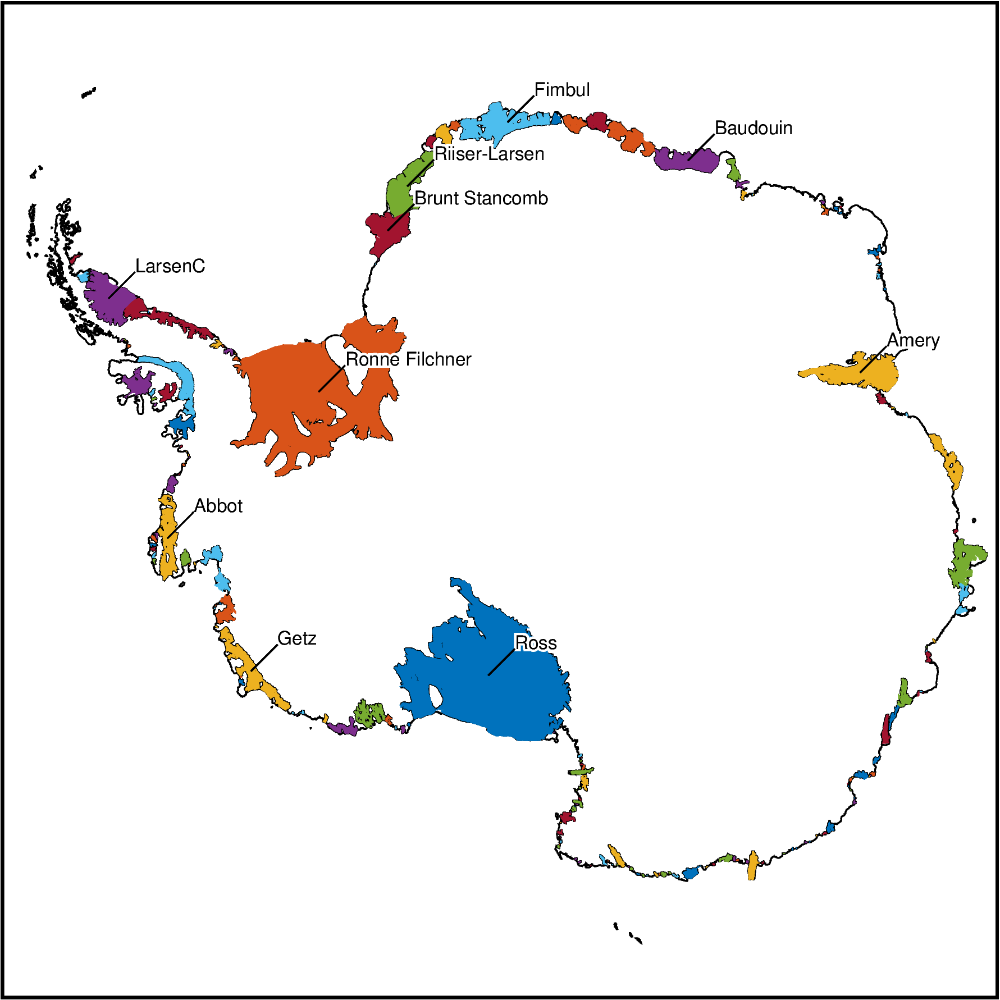

In [4]:
# choose how many ice shelves to plot
df = ice_shelves.iloc[:]

# plot basemap with coastline and grounding lines
fig = maps.basemap(
    region=regions.antarctica,
    coast=True,
)

# plot ice shelves
fig.plot(
    df,
    close=True,
    fill="auto",
)

# plot names
ice_shelf_stats.plot_ice_shelf_names(fig, df.iloc[0:10])

fig.show()

In [5]:
ice_shelves.NAME.unique()

array(['Ross', 'Ronne_Filchner', 'Amery', 'LarsenC', 'Riiser-Larsen',
       'Fimbul', 'Brunt_Stancomb', 'Getz', 'Baudouin', 'Abbot',
       'Shackleton', 'George_VI', 'LarsenD', 'Borchgrevink', 'West',
       'Wilkins', 'Sulzberger', 'Jelbart', 'Lazarev', 'Stange', 'Nivl',
       'Ekstrom', 'Nickerson', 'Totten', 'Pine_Island',
       'Moscow_University', 'Dotson', 'Mertz', 'Prince_Harald',
       'Thwaites', 'Bach', 'Cook', 'Crosson', 'Rennick', 'Venable',
       'Cosgrove', 'Tracy_Tremenchus', 'Mariner', 'Holmes', 'Drygalski',
       'LarsenB', 'Quar', 'Vigrid', 'Atka', 'Nansen', 'Ninnis',
       'Conger_Glenzer', 'Publications', 'Dibble', 'LarsenE',
       'Vincennes_Bay', 'WilmaRobertDowner', 'Swinburne', 'Shirase',
       'LarsenF', 'Aviator', 'Lillie', 'LarsenA', 'Voyeykov',
       'Rayner_Thyer', 'Land', 'Withrow', 'Lauritzen', 'Mendelssohn',
       'Tucker', 'Edward_VIII', 'LarsenG', 'Hannan', 'Fitzgerald',
       'Mulebreen', 'Helen', 'Wordie', 'Slava', 'Williamson', 'Zubchat

# Constraints and median distance

### create files for each ice shelves: csv for constraints and netcdf for min distances

In [ ]:
# # for an individual ice shelf
# ice_shelf_stats.constraints_and_min_distances_single(
#     ice_shelves[ice_shelves.NAME == "Jelbart"].iloc[0],
#     version="bedmachine",
#     spacing=100,
#     buffer=20e3,
#     plot=True,
#     # fname="../results/ice_shelves/Barber",
# )

In [ ]:
# # for a range of ice shelves
# ice_shelf_stats.constraints_and_min_distances(
#     ice_shelves,
#     version="bedmachine",
#     spacing=100,
#     buffer=20e3,
#     # plot=True,
#     # save_plot=True,
#     file_path="../results/ice_shelves/",
# )

### Load the files, calculate stats and plot

In [4]:
ice_shelves[ice_shelves.NAME=="Shackleton"]

,NAME,Regions,TYPE,geometry,area_km
10,Shackleton,East,FL,"POLYGON ((2633675.060 -479241.005, 2632371.431...",26927.9


In [6]:
# for a range of ice shelves
ice_shelves_subset = ice_shelf_stats.load_constraints_and_min_distances(
    ice_shelves.iloc[:],
    # plot=True,
    # save_plot=True,
    file_path="../results/ice_shelves/",
)
ice_shelves_subset

Ice Shelves:   0%|          | 0/164 [00:00<?, ?it/s]

,NAME,Regions,TYPE,geometry,area_km,median_constraint_distance,mean_constraint_distance,max_constraint_distance,constraint_proximity_skewness
0,Ross,West,FL,"POLYGON ((-240677.184 -678259.006, -240038.274...",480428.37,17.282824,17.636882,62.339089,0.431810
1,Ronne_Filchner,West,FL,"POLYGON ((-1006734.891 880592.980, -1006335.92...",427041.70,7.686515,8.739788,46.338298,1.456174
2,Amery,East,FL,"POLYGON ((2134701.422 618463.117, 2131452.011 ...",60797.28,16.941666,21.373582,74.852666,0.844014
3,LarsenC,Peninsula,FL,"POLYGON ((-2235724.269 1271352.188, -2235828.5...",47443.51,9.067471,10.260593,36.855613,0.763313
4,Riiser-Larsen,East,FL,"POLYGON ((-592166.317 1592824.258, -593783.160...",42913.14,17.664812,20.596557,63.202992,0.713248
...,...,...,...,...,...,...,...,...,...
159,Perkins,West,FL,"POLYGON ((-1129608.753 -1201300.734, -1130034....",7.01,2.075342,2.112520,3.596783,0.276165
160,Paternostro,East,FL,"POLYGON ((824294.485 -2115301.607, 823916.673 ...",6.55,4.640709,4.706416,6.268170,0.309649
161,Arneb,East,FL,"POLYGON ((333867.825 -1897953.452, 333673.461 ...",6.41,0.472634,0.514199,1.489991,0.395076
162,Falkner,East,FL,"POLYGON ((425350.532 -1726631.609, 423726.753 ...",5.69,2.028684,2.044244,3.443504,0.326008


# Gravity anomalies

### Calculate gravity anomalies and save to a csv
loads constraints from file so they must exist already (use the above functions)

In [ ]:
# # for an individual ice shelf
# ice_shelf_stats.gravity_anomalies_single(
#     ice_shelves[ice_shelves.NAME == "Getz"].iloc[0],
#     buffer=10e3,
#     spacing = 5e3,
#     constraints_df=pd.read_csv("../results/ice_shelves/Getz_constraints.csv.gz"),
#     regional_grav_kwargs=dict(
#         method="constraints",
#         grid_method="pygmt",
#         tension_factor=0,
#     ),
#     progressbar=True,
#     plot=True,
#     fname="../results/ice_shelves/Getz",
# )


In [ ]:
# logging.getLogger("polartoolkit").setLevel(logging.WARN)

# # for a range of ice shelves
# ice_shelf_stats.gravity_anomalies(
#     ice_shelves.iloc[:],
#     buffer = 10e3,
#     spacing = 5e3, # AntGG is 5km, so no need to go finer
#     regional_grav_kwargs=dict(
#         method="constraints",
#         grid_method="pygmt",
#         tension_factor=0, # was 2.5, but 0 adheres to the constraints better
#     ),
#     progressbar=True,
#     # plot=True, # THIS ADDS A LOT OF TIME!!
#     # save_plot=True,
#     file_path="../results/ice_shelves/",
# )

### Load the files, calculate stats and plot

In [127]:
# # for a range of ice shelves
# ice_shelves_subset = ice_shelf_stats.load_grav_anomalies(
#     ice_shelves[:],
#     # plot=True,
#     # save_plot=True,
#     file_path="../results/ice_shelves/",
# )
# ice_shelves_subset

# Load constraints, minimum distances, and gravity anomaly files

In [26]:
# # for an individual ice shelf
# shelf = ice_shelf_stats.load_ice_shelf_info_single(
#     # ice_shelves.iloc[80],
#     ice_shelves[ice_shelves.NAME=="Tracy_Tremenchus"].iloc[0],
#     plot=True,
#     # save_plot=False,
#     file_path="../results/ice_shelves/",
# )
# shelf

In [ ]:
# ice_shelves[ice_shelves.NAME=="Amery"]

,NAME,Regions,TYPE,geometry,area_km
2,Amery,East,FL,"POLYGON ((2134701.422 618463.117, 2131452.011 ...",60797.28


In [ ]:
# for a range of ice shelves
ice_shelf_stats_gdf = ice_shelf_stats.load_ice_shelf_info(
    ice_shelves.iloc[:],
    plot=True,
    save_plot=True,
    file_path="../results/ice_shelves/",
)
ice_shelf_stats_gdf

## Clean up NaNs and outliers

In [45]:
# drop rows with any NaNs
to_drop = ice_shelf_stats_gdf[ice_shelf_stats_gdf.isna().any(axis=1)]
print(to_drop.NAME)

ice_shelf_stats_gdf = ice_shelf_stats_gdf.drop(to_drop.index).reset_index(drop=True)

ice_shelf_stats_gdf.describe()

121                Porter
124                Alison
126               Skallen
128              Garfield
129          Hummer_Point
130    Commandant_Charcot
131                 Suter
132               Gannutz
133            Harmon_Bay
134              Fox_East
136               Britten
138        Dawson_Lambton
139              Sandford
140                Barber
141              Fox_West
142                 Morse
143              Chugunov
144                 Telen
145                Erebus
146                 Hovde
147                McLeod
148                Kirkby
149               Liotard
150      Quatermain_Point
151             ClarkeBay
152               Manhaul
153        CapeWashington
154     Hayes_Coats_Coast
155                 Marin
156               Rydberg
157           Eltanin_Bay
158            Rose_Point
159               Perkins
160           Paternostro
161                 Arneb
162               Falkner
163     Hamilton_Piedmont
Name: NAME, dtype: object


,median_constraint_distance,mean_constraint_distance,max_constraint_distance,constraint_proximity_skewness,gravity_disturbance_rms,gravity_disturbance_stdev,partial_topo_free_disturbance_rms,partial_topo_free_disturbance_stdev,topo_free_disturbance_rms,topo_free_disturbance_stdev,...,reg_rms,reg_stdev,res_rms,res_stdev,error_rms,error_stdev,residual_constraint_proximity_ratio_rms,residual_constraint_proximity_ratio_stdev,regional_constraint_proximity_ratio_rms,regional_constraint_proximity_ratio_stdev
count,127.000000,127.000000,127.000000,127.000000,127.000000,127.000000,127.000000,127.000000,127.000000,127.000000,...,127.000000,127.000000,127.000000,127.000000,127.000000,127.000000,127.000000,127.000000,127.000000,127.000000
mean,7.124834,7.733093,20.343062,0.404379,55.395058,16.125496,55.006887,15.995789,42.965448,14.269271,...,41.741517,13.269906,9.233804,6.893871,8.493863,1.245829,141.286875,111.726170,365.821890,223.302551
std,5.314390,5.718142,16.434529,0.405489,34.679864,12.956594,34.414389,12.928442,29.009872,12.149293,...,28.877715,12.237235,8.415155,5.295764,2.968893,0.983219,233.768315,158.565832,394.642813,276.108295
min,1.102750,1.103613,2.569476,-0.658548,3.632344,0.197733,3.506951,0.070290,3.975761,0.614160,...,3.539926,0.404523,1.012266,0.305461,3.798641,0.002048,2.012815,0.693862,5.961978,5.669075
25%,3.714447,4.062338,9.438007,0.120974,28.286185,7.333049,27.922064,6.844218,20.796391,6.365549,...,20.701664,5.791109,3.640236,2.870796,6.479849,0.321911,18.791350,15.639612,120.489048,60.584551
50%,5.749979,6.168523,14.461560,0.408027,48.432745,13.582903,47.629754,12.893290,36.508760,10.540163,...,35.173667,9.639138,5.932582,5.277120,8.285409,1.167709,46.692564,40.968744,221.415370,128.238943
75%,8.093071,8.786355,26.429642,0.704091,78.808785,20.482688,78.016842,20.583826,58.249511,17.323973,...,57.179675,16.455952,12.774517,9.404192,9.634286,1.884681,162.612316,140.877009,430.546385,244.262757
max,32.468017,32.413522,84.476658,1.548030,201.018641,72.044363,199.385378,72.058829,169.763722,66.049467,...,161.174787,66.278609,50.607304,31.512811,15.204343,4.057948,1796.114980,771.341520,2026.638735,1438.959198


In [46]:
stats_to_check = [
    'gravity_disturbance_stdev',
    'partial_topo_free_disturbance_stdev',
    'topo_free_disturbance_stdev',
    'starting_gravity_stdev',
    'reg_stdev',
    'res_stdev',
    # 'error_stdev',
    "median_constraint_distance",
    "max_constraint_distance",
    "constraint_proximity_skewness",
]

stats_df = ice_shelf_stats_gdf[stats_to_check].apply(sp.stats.zscore)

outliers = stats_df[(stats_df > 4).any(axis=1)]
cols = outliers.columns.tolist()
outliers = outliers.merge(ice_shelf_stats_gdf[["NAME"]], left_index=True, right_index=True, how="left")
outliers = outliers[["NAME"]+cols]
print(outliers.NAME.unique())
outliers

['Ekstrom' 'Conger_Glenzer' 'Suvorov']


,NAME,gravity_disturbance_stdev,partial_topo_free_disturbance_stdev,topo_free_disturbance_stdev,starting_gravity_stdev,reg_stdev,res_stdev,median_constraint_distance,max_constraint_distance,constraint_proximity_skewness
21,Ekstrom,4.332954,4.353585,4.278872,-0.071854,4.348910,-0.383910,-0.829582,-0.307839,1.701567
46,Conger_Glenzer,0.311252,0.320341,0.538742,-0.811529,1.079565,0.913323,4.787671,1.797556,-0.982396
81,Suvorov,-0.723206,-0.715071,-0.337809,-0.053293,2.247578,4.667210,0.014722,0.356694,2.273685


In [3]:
# outlier_stats = ice_shelf_stats.load_ice_shelf_info(
#     ice_shelves[ice_shelves.NAME.isin(outliers.NAME.unique())],
#     plot=True,
#     file_path="../results/ice_shelves/",
# )
# outlier_stats

In [49]:
# decide to drop these shelves
# ice_shelf_stats_gdf = ice_shelf_stats_gdf.drop(outlier_stats.index).reset_index(drop=True)

In [47]:
ice_shelf_stats_gdf = ice_shelf_stats_gdf.sort_values("area_km", ascending=False).reset_index(drop=True)
ice_shelf_stats_gdf

,NAME,Regions,TYPE,geometry,area_km,median_constraint_distance,mean_constraint_distance,max_constraint_distance,constraint_proximity_skewness,gravity_disturbance_rms,...,reg_rms,reg_stdev,res_rms,res_stdev,error_rms,error_stdev,residual_constraint_proximity_ratio_rms,residual_constraint_proximity_ratio_stdev,regional_constraint_proximity_ratio_rms,regional_constraint_proximity_ratio_stdev
0,Ross,West,FL,"POLYGON ((-240677.184 -678259.006, -240038.274...",480428.37,17.282824,17.636882,62.339089,0.431810,44.934094,...,17.851020,17.380028,5.932582,5.931834,12.748633,3.154937,129.988110,129.983190,306.318730,291.707559
1,Ronne_Filchner,West,FL,"POLYGON ((-1006734.891 880592.980, -1006335.92...",427041.7,7.686515,8.739788,46.338298,1.456174,41.514238,...,34.019412,20.803884,3.958367,3.955927,7.952294,1.760702,59.403593,59.405243,350.428117,251.256955
2,Amery,East,FL,"POLYGON ((2134701.422 618463.117, 2131452.011 ...",60797.28,16.941666,21.373582,74.852666,0.844014,54.656450,...,40.967810,25.416420,14.932758,12.592517,8.432001,0.497149,504.180788,443.561742,1176.362259,869.215104
3,LarsenC,Peninsula,FL,"POLYGON ((-2235724.269 1271352.188, -2235828.5...",47443.51,9.067471,10.260593,36.855613,0.763313,14.824574,...,38.552686,14.808293,5.083237,5.084219,5.735885,1.390208,69.270786,69.137847,509.713990,330.660555
4,Riiser-Larsen,East,FL,"POLYGON ((-592166.317 1592824.258, -593783.160...",42913.14,17.664812,20.596557,63.202992,0.713248,53.556828,...,81.143217,41.570157,12.794650,12.025394,8.285409,0.728764,448.277737,435.945629,2026.638735,1361.039287
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122,Drury,East,FL,"POLYGON ((895410.318 -2105991.071, 895410.318 ...",55.61,3.143890,3.746163,9.463699,0.496175,85.931453,...,65.638189,0.404523,3.380092,3.648856,12.959736,0.030865,25.727613,26.699924,391.494092,192.394950
123,Zelee,East,FL,"POLYGON ((1595256.149 -1990608.354, 1594944.21...",40.65,2.835378,2.856841,6.070070,0.102221,56.605168,...,47.884443,17.421925,5.840224,3.653810,6.485042,1.849987,24.465782,20.543170,109.899298,59.122902
124,Dalk,East,FL,"POLYGON ((2199011.876 527659.283, 2197112.442 ...",35.44,1.102750,1.103613,2.569476,0.153243,9.456864,...,9.471496,4.549504,1.696235,1.696235,8.295042,0.233987,2.681972,2.681972,6.377484,5.936761
125,Marret,East,FL,"POLYGON ((1739518.675 -1925310.880, 1739760.36...",26.08,1.629186,1.762193,4.782843,0.875108,67.773671,...,35.269017,3.507923,2.258032,2.983219,14.314831,0.472625,4.721960,5.635562,64.876020,33.804194


## Save and load to csv

In [ ]:
# ice_shelf_stats_gdf.to_csv("../results/ice_shelves/ice_shelf_gravity_stats.csv", index=False,)

In [5]:
df = pd.read_csv("../results/ice_shelves/ice_shelf_gravity_stats.csv", index_col=None)

# turn back into geodataframe
ice_shelf_stats_gdf_full = gpd.GeoDataFrame(
    df,
    geometry=gpd.GeoSeries.from_wkt(df['geometry'], crs="EPSG:3031"),
    crs="EPSG:3031",
)
ice_shelf_stats_gdf = ice_shelf_stats_gdf_full[ice_shelf_stats_gdf_full.area_km >1000]
ice_shelf_stats_gdf

,NAME,Regions,TYPE,geometry,area_km,median_constraint_distance,mean_constraint_distance,max_constraint_distance,constraint_proximity_skewness,gravity_disturbance_rms,...,reg_rms,reg_stdev,res_rms,res_stdev,error_rms,error_stdev,residual_constraint_proximity_ratio_rms,residual_constraint_proximity_ratio_stdev,regional_constraint_proximity_ratio_rms,regional_constraint_proximity_ratio_stdev
0,Ross,West,FL,"POLYGON ((-240677.184 -678259.006, -240038.274...",480428.37,17.282824,17.636882,62.339089,0.431810,44.934094,...,17.851020,17.380028,5.932582,5.931834,12.748633,3.154937,129.988110,129.983190,306.318730,291.707559
1,Ronne_Filchner,West,FL,"POLYGON ((-1006734.891 880592.980, -1006335.92...",427041.70,7.686515,8.739788,46.338298,1.456174,41.514238,...,34.019412,20.803884,3.958367,3.955927,7.952294,1.760702,59.403593,59.405243,350.428117,251.256955
2,Amery,East,FL,"POLYGON ((2134701.422 618463.117, 2131452.011 ...",60797.28,16.941666,21.373582,74.852666,0.844014,54.656450,...,40.967810,25.416420,14.932758,12.592517,8.432001,0.497149,504.180788,443.561742,1176.362259,869.215104
3,LarsenC,Peninsula,FL,"POLYGON ((-2235724.269 1271352.188, -2235828.5...",47443.51,9.067471,10.260593,36.855613,0.763313,14.824574,...,38.552686,14.808293,5.083237,5.084219,5.735885,1.390208,69.270786,69.137847,509.713990,330.660555
4,Riiser-Larsen,East,FL,"POLYGON ((-592166.317 1592824.258, -593783.160...",42913.14,17.664812,20.596557,63.202992,0.713248,53.556828,...,81.143217,41.570157,12.794650,12.025394,8.285409,0.728764,448.277737,435.945629,2026.638735,1361.039287
5,Fimbul,East,FL,"POLYGON ((145423.961 2176737.792, 145088.314 2...",40947.75,5.450097,6.460643,26.199066,1.391103,55.666475,...,85.347406,37.440493,8.633533,8.292620,6.037483,1.283386,109.233174,105.179714,650.592081,427.162707
6,Brunt_Stancomb,East,FL,"POLYGON ((-648673.952 1612385.898, -648144.200...",36137.10,14.462157,18.965093,66.878832,0.713434,31.663309,...,60.412046,37.760943,16.026034,14.013457,5.764394,2.020729,449.637678,399.008397,1177.032382,828.056156
7,Getz,West,FL,"MULTIPOLYGON (((-1464395.442 -1011065.611, -14...",33389.04,10.337270,11.505782,40.419329,0.774685,45.815742,...,12.235380,9.362355,17.049849,11.769703,6.840661,2.799637,291.644600,226.454433,143.686027,113.164656
8,Baudouin,East,FL,"POLYGON ((894980.201 1963931.580, 894465.744 1...",33129.24,22.523870,24.018180,72.093600,0.635214,37.878304,...,56.576877,42.383386,20.728125,16.700756,7.175396,1.815555,848.553293,726.514827,1652.047369,1314.374220
9,Abbot,West,FL,"MULTIPOLYGON (((-1946681.999 -330470.661, -194...",31389.73,9.786923,10.943510,34.300815,0.673908,28.653549,...,27.493075,17.666851,22.916002,17.028213,6.650965,1.750310,344.822224,276.024068,321.903313,225.748172


In [51]:
df = ice_shelf_stats_gdf_full.sort_values("median_constraint_distance", ascending=False).reset_index(drop=True)
val = df[df.NAME=="Ross"].index[0]
print(f"{val+1} out of {len(ice_shelves)} ice shelves")
print(f"{((val+1)/len(ice_shelves))*100} %")

9 out of 164 ice shelves
5.487804878048781 %


In [52]:
ice_shelf_stats_gdf_full.sort_values("max_constraint_distance", ascending=False).reset_index(drop=True).iloc[0:10]

,NAME,Regions,TYPE,geometry,area_km,median_constraint_distance,mean_constraint_distance,max_constraint_distance,constraint_proximity_skewness,gravity_disturbance_rms,...,reg_rms,reg_stdev,res_rms,res_stdev,error_rms,error_stdev,residual_constraint_proximity_ratio_rms,residual_constraint_proximity_ratio_stdev,regional_constraint_proximity_ratio_rms,regional_constraint_proximity_ratio_stdev
0,Shackleton,East,FL,"POLYGON ((2633675.060 -479241.005, 2632371.431...",26927.90,26.857001,30.320176,84.476658,0.528034,34.623367,...,18.903968,16.254440,22.644630,20.656154,8.183697,1.713532,771.946382,723.330992,631.427400,512.006961
1,Amery,East,FL,"POLYGON ((2134701.422 618463.117, 2131452.011 ...",60797.28,16.941666,21.373582,74.852666,0.844014,54.656450,...,40.967810,25.416420,14.932758,12.592517,8.432001,0.497149,504.180788,443.561742,1176.362259,869.215104
2,Baudouin,East,FL,"POLYGON ((894980.201 1963931.580, 894465.744 1...",33129.24,22.523870,24.018180,72.093600,0.635214,37.878304,...,56.576877,42.383386,20.728125,16.700756,7.175396,1.815555,848.553293,726.514827,1652.047369,1314.374220
3,Brunt_Stancomb,East,FL,"POLYGON ((-648673.952 1612385.898, -648144.200...",36137.10,14.462157,18.965093,66.878832,0.713434,31.663309,...,60.412046,37.760943,16.026034,14.013457,5.764394,2.020729,449.637678,399.008397,1177.032382,828.056156
4,Riiser-Larsen,East,FL,"POLYGON ((-592166.317 1592824.258, -593783.160...",42913.14,17.664812,20.596557,63.202992,0.713248,53.556828,...,81.143217,41.570157,12.794650,12.025394,8.285409,0.728764,448.277737,435.945629,2026.638735,1361.039287
5,Ross,West,FL,"POLYGON ((-240677.184 -678259.006, -240038.274...",480428.37,17.282824,17.636882,62.339089,0.431810,44.934094,...,17.851020,17.380028,5.932582,5.931834,12.748633,3.154937,129.988110,129.983190,306.318730,291.707559
6,Prince_Harald,East,FL,"MULTIPOLYGON (((1367928.932 1754234.348, 13668...",5455.02,25.980222,25.862225,61.765863,0.128630,33.425492,...,29.831646,28.864628,11.834767,11.692189,8.431992,0.050487,399.320962,389.482894,709.031114,705.002030
7,Wilkins,Peninsula,FL,"POLYGON ((-2099746.399 584996.044, -2100523.90...",12906.75,17.496130,19.212720,57.283478,0.526020,17.100584,...,20.695797,10.801198,15.297493,11.032456,7.178177,1.613022,362.386541,294.643191,572.066959,387.935182
8,West,East,FL,"POLYGON ((2563983.553 220837.286, 2563003.768 ...",16082.67,14.361596,16.644050,54.804727,0.791998,22.957914,...,43.608064,14.175448,14.442713,13.401871,7.049417,1.611335,315.665047,309.124004,838.412816,489.511895
9,Conger_Glenzer,East,FL,"POLYGON ((2569966.039 -636188.979, 2570323.627...",1600.94,32.468017,32.413522,49.768507,0.007600,20.600937,...,42.932761,26.428682,50.607304,11.711532,7.846109,2.314243,1796.114980,643.502419,1652.216000,1072.706525


## Antarctica-wide plots

In [ ]:
# # min_dists = []
# # names = []
# min_dist_dfs = []

# # fig, ax = plt.subplots(figsize=(5, 3))

# for i, row in ice_shelves.iloc[:].iterrows():
#     try:
#         min_dist = xr.open_dataarray(f"../results/ice_shelves/{row.NAME}_min_dist.nc")
#         # min_dists.append(
#         #     pd.Series(min_dist.values.ravel()).dropna(),
#         # )
#         vals = pd.Series(min_dist.values.ravel()).dropna()[::10]
#         min_dist_dfs.append(
#             pd.DataFrame(
#                 vals, columns=[row.NAME])#.reset_index(drop=True),
#         )
#         # names.append(row.NAME)

#         # min_dist.plot.hist(ax=ax, label=row.NAME)
#         # sns.displot(data=min_dist.values.ravel(), kind="kde", ax=ax)

#     except FileNotFoundError:
#         print(f"File not found for {row.NAME}")

# # df = pd.DataFrame(min_dists, index=names)
# # df

In [140]:
# df = pd.concat(min_dist_dfs, ).dropna(how="all")
# df

In [141]:
# import joypy
# fig, axes = joypy.joyplot(
#     df,
#     ylabels=False,
#     xlabels=False,
#     grid=False,
#     fill=False,
#     linewidth=1,
#     #                     grid="y", linewidth=1, legend=False, fade=True, figsize=(6,5),
#     #                     title="Global daily temperature 1880-2014 \n(°C above 1950-80 average)",
#     #                     kind="counts", bins=30
# )

In [142]:
# sns.displot(
#     data=df,
#     kind="kde",
#     label=False,
#     color="b",
# )

In [143]:
# sns.displot(
#     data=pd.DataFrame(min_dists),
#     # x="carat",
#     # hue="cut",
#     kind="kde",
#     height=6,
#     # multiple="fill",
#     # clip=(0, None),
#     # palette="ch:rot=-.25,hue=1,light=.75",
# )

In [144]:
# df = pd.concat(min_dist_dfs)

# # plot
# # Initialize the FacetGrid object
# pal = sns.cubehelix_palette(len(df.label.unique()), rot=-.25, light=.7)
# g = sns.FacetGrid(df, row="label", hue="label", aspect=15, height=.5, palette=pal)

# # Draw the densities in a few steps
# g.map(sns.kdeplot, "intensity", bw_adjust=.5, clip_on=False, fill=True, alpha=1, linewidth=1.5)
# g.map(sns.kdeplot, "intensity", clip_on=False, color="w", lw=2, bw_adjust=.5)
# g.map(plt.axhline, y=0, lw=2, clip_on=False)

# # Define and use a simple function to label the plot in axes coordinates
# def label(x, color, label):
#     ax = plt.gca()
#     ax.text(0, .2, label, fontweight="bold", color=color, ha="left", va="center", transform=ax.transAxes)

# g.map(label, "intensity")

# # Set the subplots to overlap
# g.fig.subplots_adjust(hspace=-.25)

# # Remove axes details that don't play well with overlap
# g.set_titles("")
# g.set(yticks=[])
# g.despine(bottom=True, left=True)

In [70]:
# dfs = []
# for i, row in ice_shelves.iterrows():
#     try:
#         df = pd.read_csv(
#             f"../results/ice_shelves/{row.NAME}_constraints.csv.gz",
#             sep=",",
#             header=0,
#             index_col=None,
#             encoding="utf-8",
#             compression="gzip",
#         )
#         dfs.append(df)
#     except FileNotFoundError:
#         print(f"File not found for {row.NAME}")
# antarctic_bed_points = pd.concat(dfs)
# antarctic_bed_points.describe()

In [ ]:
# save to files
# antarctic_bed_points.to_csv(
#     "../results/ice_shelves/antarctica_constraints.csv.gz",
#     sep=",",
#     na_rep="",
#     header=True,
#     index=False,
#     encoding="utf-8",
#     compression="gzip",
# )

In [7]:
coords = vd.grid_coordinates(
    region=regions.antarctica,
    spacing=500,
)
grid = vd.make_xarray_grid(coords, np.ones_like(coords[0]), data_names="z").z

min_dist = utils.dist_nearest_points(
    antarctic_bed_points,
    data=grid,
).min_dist

min_dist = min_dist/1e3

In [8]:
# mask to ice shelf regions
min_dist = polar_utils.mask_from_shp(
    shapefile=ice_shelves,
    xr_grid=min_dist,
    invert=False,
    masked=True,
)

In [9]:
# save to files
min_dist.to_netcdf("../results/ice_shelves/antarctica_min_dist.nc")

In [45]:
# read from files
min_dist = xr.open_dataarray("../results/ice_shelves/antarctica_min_dist.nc")
antarctic_bed_points = pd.read_csv(
    "../results/ice_shelves/antarctica_constraints.csv.gz",
    sep=",",
    header=0,
    index_col=None,
    encoding="utf-8",
    compression="gzip",
)

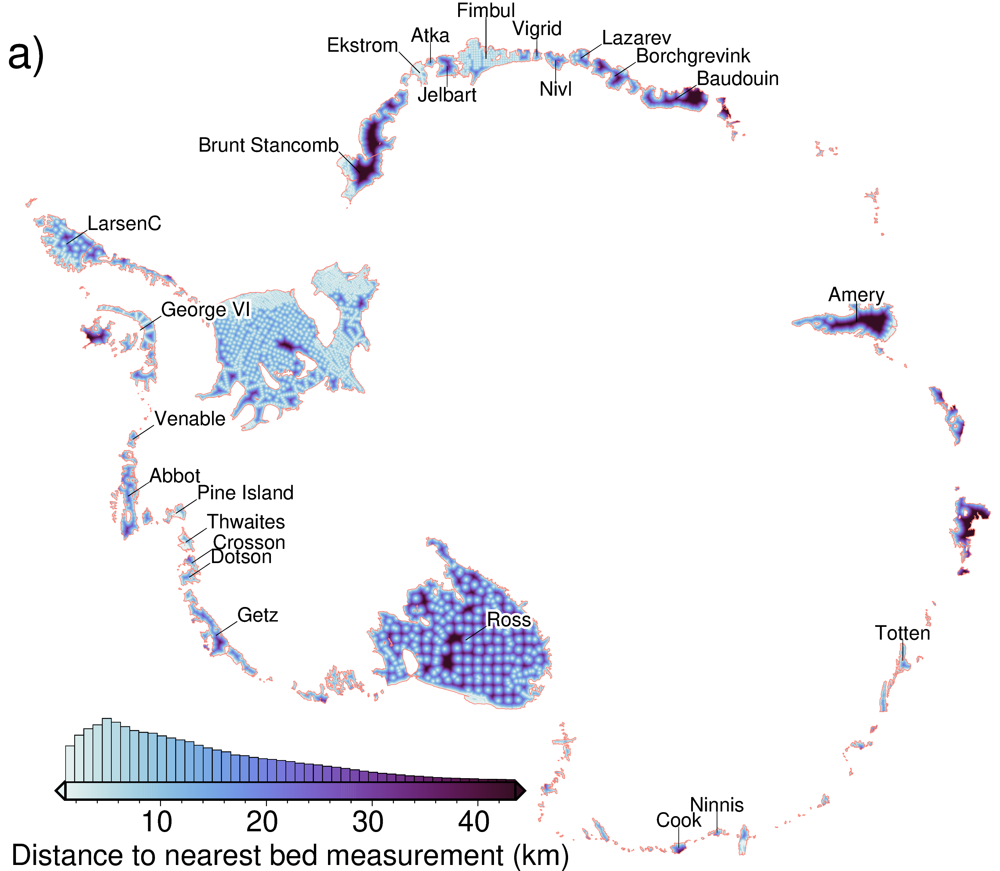

In [46]:
# define region around antarctica with a buffer
reg = polar_utils.region_to_bounding_box(
    gpd.read_file(fetch.antarctic_boundaries(version="Coastline")).bounds.values[0]
)
reg = vd.pad_region(reg, 50e3)

fig = maps.plot_grd(
    min_dist,
    region=reg,
    fig_height=12,
    frame=False,
    cmap="dense",
    robust=True,
    hist=True,
    cbar_label="Distance to nearest bed measurement (km)",
    cbar_font="18p,Helvetica",
    cbar_width_perc=.45,
    cbar_yoffset=-1.2,
    cbar_xoffset=-3,
    cbar_hist_height=1,
)
fig.plot(
    ice_shelves,
    pen="0.2p,salmon",
)


df = ice_shelves[ice_shelves.NAME.isin(ice_shelf_stats.inverted_shelves)]
# df = ice_shelves.iloc[0:10]

# plot shelves with labels above
names = ["Totten", "Cook", "Ninnis", "Amery", "Vigrid", "Atka"]
ice_shelf_stats.plot_ice_shelf_names(
    fig,
    df[df.NAME.isin(names)],
    font="8p,Helvetica",
    shadow_font="2p,white",
    offset="0c/.3c+v.2p",
    justify="BC",
)
names1 = ["Fimbul",]
ice_shelf_stats.plot_ice_shelf_names(
    fig,
    df[df.NAME.isin(names1)],
    font="8p,Helvetica",
    shadow_font="2p,white",
    offset="0c/.6c+v.2p",
    justify="BC",
)

# plot shelves with labels above and to left
names2 = ["Brunt_Stancomb", "Ekstrom",]
ice_shelf_stats.plot_ice_shelf_names(
    fig,
    df[df.NAME.isin(names2)],
    font="8p,Helvetica",
    shadow_font="2p,white",
    offset="-.3c/.3c+v.2p",
    justify="BR",
)

# plot shelves with labels below
names3=["Jelbart", "Nivl",]
ice_shelf_stats.plot_ice_shelf_names(
    fig,
    df[df.NAME.isin(names3)],
    font="8p,Helvetica",
    shadow_font="2p,white",
    offset="0c/-.3c+v.2p",
    justify="TC",
)

# plot remaning shelves with labels above and to right
ice_shelf_stats.plot_ice_shelf_names(
    fig,
    df[~df.NAME.isin(names+names1+names2+names3)],
    font="8p,Helvetica",
    shadow_font="2p,white",
    offset=".3c/.2c+v.2p",
    justify="BL",
)

fig.text(  # type: ignore[attr-defined]
    justify="TL",
    position="TL",
    offset=".1c/-.1c",
    text="a)",  # type: ignore[index]
    font="18p,Helvetica,black",
    no_clip=True,
)

fig.show(dpi=500)

In [48]:
dfs = []
for i, row in ice_shelves.iterrows():
    try:
        dfs.append(
            pd.read_csv(
                (f"../results/ice_shelves/{row.NAME}_grav_anomalies.csv.gz")
            )
        )
    except FileNotFoundError:
        print(f"File not found for {row.NAME}")

grav_df = pd.concat(dfs)

grav_grids = []
for col in [
    "gravity_disturbance",
    "topo_free_disturbance",
    "reg",
    "res",
    "error"
]:
    grd = pygmt.xyz2grd(
        x=grav_df.easting,
        y=grav_df.northing,
        z=grav_df[col],
        region=reg,
        spacing=5e3,
    ).rename(col)

    # mask to ice shelf regions
    grd = polar_utils.mask_from_shp(
        shapefile=ice_shelves,
        xr_grid=grd,
        invert=False,
        masked=True,
    )
    grav_grids.append(grd)

grav_grid = xr.merge(grav_grids)
grav_grid

xyz2grd [WARNING]: (x_max-x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
xyz2grd [WARNING]: (y_max-y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
xyz2grd (gmtapi_init_grdheader): Please select compatible -R and -I values
xyz2grd [WARNING]: (x_max-x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
xyz2grd [WARNING]: (y_max-y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
xyz2grd (gmtapi_init_grdheader): Please select compatible -R and -I values
xyz2grd [WARNING]: (x_max-x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
xyz2grd [WARNING]: (y_max-y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
xyz2grd (gmtapi_init_grdheader): Please select compatible -R and -I values
xyz2grd [WARNING]: (x_max-x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
xyz2grd [WAR

<xarray.Dataset> Size: 19MB
Dimensions:                (y: 898, x: 1072)
Coordinates:
  * y                      (y) float64 7kB -2.194e+06 -2.189e+06 ... 2.291e+06
  * x                      (x) float64 9kB -2.558e+06 -2.553e+06 ... 2.795e+06
Data variables:
    gravity_disturbance    (y, x) float32 4MB nan nan nan nan ... nan nan nan
    topo_free_disturbance  (y, x) float32 4MB nan nan nan nan ... nan nan nan
    reg                    (y, x) float32 4MB nan nan nan nan ... nan nan nan
    res                    (y, x) float32 4MB nan nan nan nan ... nan nan nan
    error                  (y, x) float32 4MB nan nan nan nan ... nan nan nan
Attributes:
    Conventions:   CF-1.7
    title:         
    history:       gmt xyz2grd @GMTAPI@-S-I-D-V-T-N-000000 -G@GMTAPI@-S-O-G-G...
    description:   
    actual_range:  [nan nan]
    long_name:     z

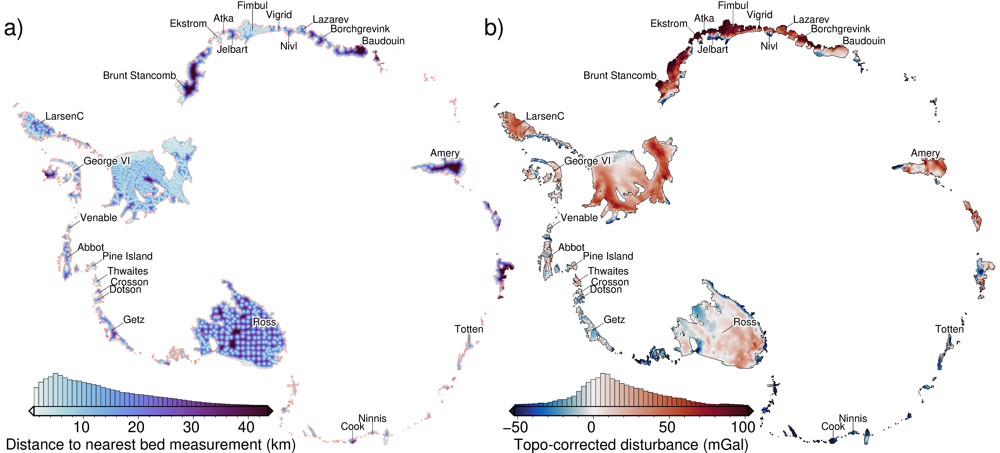

In [49]:
fig = maps.plot_grd(
    grav_grid.topo_free_disturbance,
    fig=fig,
    origin_shift="x",
    xshift_amount=.9,
    region=reg,
    fig_height=12,
    frame=False,
    cmap="balance+h0",
    robust=True,
    hist=True,
    cbar_label=f"Topo-corrected disturbance (mGal)",
    cbar_font="18p,Helvetica",
    cbar_width_perc=.45,
    cbar_yoffset=-1.2,
    cbar_xoffset=-3,
    cbar_hist_height=1,
)

fig.plot(
    ice_shelves,
    pen="0.2p,black",
)

df = ice_shelves[ice_shelves.NAME.isin(ice_shelf_stats.inverted_shelves)]
# df = ice_shelves.iloc[0:10]

# plot shelves with labels above
names = ["Totten", "Cook", "Ninnis", "Amery", "Vigrid", "Atka"]
ice_shelf_stats.plot_ice_shelf_names(
    fig,
    df[df.NAME.isin(names)],
    font="8p,Helvetica",
    shadow_font="2p,white",
    offset="0c/.3c+v.2p",
    justify="BC",
)
names1 = ["Fimbul",]
ice_shelf_stats.plot_ice_shelf_names(
    fig,
    df[df.NAME.isin(names1)],
    font="8p,Helvetica",
    shadow_font="2p,white",
    offset="0c/.6c+v.2p",
    justify="BC",
)

# plot shelves with labels above and to left
names2 = ["Brunt_Stancomb", "Ekstrom",]
ice_shelf_stats.plot_ice_shelf_names(
    fig,
    df[df.NAME.isin(names2)],
    font="8p,Helvetica",
    shadow_font="2p,white",
    offset="-.3c/.3c+v.2p",
    justify="BR",
)

# plot shelves with labels below
names3=["Jelbart", "Nivl",]
ice_shelf_stats.plot_ice_shelf_names(
    fig,
    df[df.NAME.isin(names3)],
    font="8p,Helvetica",
    shadow_font="2p,white",
    offset="0c/-.3c+v.2p",
    justify="TC",
)

# plot remaning shelves with labels above and to right
ice_shelf_stats.plot_ice_shelf_names(
    fig,
    df[~df.NAME.isin(names+names1+names2+names3)],
    font="8p,Helvetica",
    shadow_font="2p,white",
    offset=".3c/.2c+v.2p",
    justify="BL",
)

fig.text(  # type: ignore[attr-defined]
    justify="TL",
    position="TL",
    offset=".1c/-.1c",
    text="b)",  # type: ignore[index]
    font="18p,Helvetica,black",
    no_clip=True,
)

fig.savefig(
    # "../paper/figures/Antarctic_topo_corrected_disturbance.png",
    "../paper/figures/Antarctic_grids.png",
    dpi=1000,
)

fig.show(dpi=500)

In [1]:
# fig = maps.plot_grd(
#     grav_grid.reg,
#     region=reg,
#     fig_width=12,
#     cbar_label=f"Regional gravity misfit (mGal)",
#     cmap="balance+h0",
#     hist=True,
#     robust=True,
# )

# fig.plot(
#     ice_shelves,
#     pen="0.2p,black",
# )

# ice_shelf_stats.plot_ice_shelf_names(
#     fig,
#     ice_shelves.iloc[0:10],
#     font="8p,Helvetica",
#     shadow_font="2p,white",
#     offset=".3c/.2c+v.2p",
# )

# fig.show(dpi=500)

In [2]:
# fig = maps.plot_grd(
#     grav_grid.res,
#     region=reg,
#     fig_width=12,
#     cbar_label=f"Residual gravity misfit (mGal)",
#     cmap="balance+h0",
#     hist=True,
#     robust=True,
# )

# fig.plot(
#     ice_shelves,
#     pen="0.2p,black",
# )

# ice_shelf_stats.plot_ice_shelf_names(
#     fig,
#     ice_shelves.iloc[0:10],
#     font="8p,Helvetica",
#     shadow_font="2p,white",
#     offset=".3c/.2c+v.2p",
# )

# fig.show(dpi=500)

## Stats for largest ice shelves

In [ ]:
# ice_shelf_stats_gdf["tc_dist_stdev_dist_stdev_ratio"] = ice_shelf_stats_gdf.topo_free_disturbance_stdev / ice_shelf_stats_gdf.gravity_disturbance_stdev

In [53]:
ice_shelf_stats_gdf[
    [
        "area_km",
        "mean_constraint_distance",
        "median_constraint_distance",
        "max_constraint_distance",
        "constraint_proximity_skewness",
        "topo_free_disturbance_stdev",
        "reg_stdev",
        "error_rms",
        # "dist_topo_free_dist_ratio_rms",
        # "tc_dist_stdev_dist_stdev_ratio",
    ]
].describe()

,area_km,mean_constraint_distance,median_constraint_distance,max_constraint_distance,constraint_proximity_skewness,topo_free_disturbance_stdev,reg_stdev,error_rms
count,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000
mean,30128.755200,11.581651,10.344047,34.304192,0.669226,22.872322,21.033887,7.271860
std,88679.087868,6.732966,6.431627,17.775279,0.290886,13.489443,13.995611,2.320993
min,1167.290000,3.413805,2.514499,13.938510,0.007600,7.647883,5.789324,3.798641
25%,2739.907500,7.314719,6.114300,21.412542,0.509376,13.991900,11.681269,5.756010
50%,6034.930000,9.858544,8.273931,29.163148,0.693578,18.353424,15.613332,6.903740
75%,22378.922500,14.930102,13.485922,42.417144,0.803303,27.637809,26.378190,8.362451
max,480428.370000,32.413522,32.468017,84.476658,1.456174,66.049467,66.278609,14.321592


In [54]:
ice_shelf_stats_gdf.median_constraint_distance.median()

8.273930533451015

In [55]:
ice_shelf_stats_gdf.topo_free_disturbance_stdev.median()

18.35342446173815

In [56]:
ice_shelf_stats_gdf[
    ice_shelf_stats_gdf.NAME.isin(ice_shelf_stats.inverted_shelves)
].sort_values("max_constraint_distance", ascending=False)[["NAME", "max_constraint_distance"]]

,NAME,max_constraint_distance
2,Amery,74.852666
8,Baudouin,72.093600
6,Brunt_Stancomb,66.878832
0,Ross,62.339089
31,Cook,45.203958
13,Borchgrevink,43.083083
7,Getz,40.419329
3,LarsenC,36.855613
17,Jelbart,34.708913
9,Abbot,34.300815


In [57]:
ice_shelf_stats_gdf.sort_values(
    "max_constraint_distance", ascending=False,
)[["NAME","max_constraint_distance"]]

,NAME,max_constraint_distance
10,Shackleton,84.476658
2,Amery,74.852666
8,Baudouin,72.093600
6,Brunt_Stancomb,66.878832
4,Riiser-Larsen,63.202992
0,Ross,62.339089
28,Prince_Harald,61.765863
15,Wilkins,57.283478
14,West,54.804727
46,Conger_Glenzer,49.768507


In [58]:
ice_shelf_stats_gdf[
    ice_shelf_stats_gdf.NAME.isin(ice_shelf_stats.inverted_shelves)
].sort_values("median_constraint_distance", ascending=False)[["NAME", "median_constraint_distance"]]

,NAME,median_constraint_distance
8,Baudouin,22.523870
0,Ross,17.282824
2,Amery,16.941666
31,Cook,16.061323
6,Brunt_Stancomb,14.462157
13,Borchgrevink,14.245119
17,Jelbart,11.208331
20,Nivl,10.667219
18,Lazarev,10.392029
7,Getz,10.337270


In [59]:
ice_shelf_stats_gdf.sort_values(
    "median_constraint_distance", ascending=False,
)[["NAME","median_constraint_distance"]]

,NAME,median_constraint_distance
46,Conger_Glenzer,32.468017
10,Shackleton,26.857001
28,Prince_Harald,25.980222
8,Baudouin,22.523870
4,Riiser-Larsen,17.664812
15,Wilkins,17.496130
0,Ross,17.282824
2,Amery,16.941666
31,Cook,16.061323
36,Tracy_Tremenchus,15.576057


In [62]:
ice_shelf_stats_gdf[
    ice_shelf_stats_gdf.NAME.isin(ice_shelf_stats.inverted_shelves)
].sort_values("constraint_proximity_skewness", ascending=False)[["NAME", "constraint_proximity_skewness"]]

,NAME,constraint_proximity_skewness
5,Fimbul,1.391103
21,Ekstrom,1.091623
29,Thwaites,0.921421
11,George_VI,0.916105
2,Amery,0.844014
26,Dotson,0.807072
7,Getz,0.774685
3,LarsenC,0.763313
32,Crosson,0.753281
45,Ninnis,0.744688


In [63]:
ice_shelf_stats_gdf.sort_values(
    "constraint_proximity_skewness", ascending=False,
)[["NAME","constraint_proximity_skewness"]]

,NAME,constraint_proximity_skewness
1,Ronne_Filchner,1.456174
5,Fimbul,1.391103
38,Holmes,1.218393
21,Ekstrom,1.091623
22,Nickerson,1.023376
16,Sulzberger,0.974902
29,Thwaites,0.921421
11,George_VI,0.916105
27,Mertz,0.852462
47,Publications,0.850635


In [64]:
ice_shelf_stats_gdf[
    ice_shelf_stats_gdf.NAME.isin(ice_shelf_stats.inverted_shelves)
].sort_values("topo_free_disturbance_stdev", ascending=False)[["NAME", "topo_free_disturbance_stdev"]]

,NAME,topo_free_disturbance_stdev
21,Ekstrom,66.049467
17,Jelbart,60.214682
6,Brunt_Stancomb,41.339700
5,Fimbul,40.567873
20,Nivl,40.106519
8,Baudouin,36.100308
13,Borchgrevink,33.254695
2,Amery,28.139752
42,Vigrid,26.846745
23,Totten,25.600091


In [65]:
ice_shelf_stats_gdf.sort_values(
    "topo_free_disturbance_stdev", ascending=False,
)[["NAME","topo_free_disturbance_stdev"]]

,NAME,topo_free_disturbance_stdev
21,Ekstrom,66.049467
39,Drygalski,61.895936
17,Jelbart,60.214682
6,Brunt_Stancomb,41.339700
5,Fimbul,40.567873
20,Nivl,40.106519
4,Riiser-Larsen,39.889037
8,Baudouin,36.100308
44,Nansen,33.308508
13,Borchgrevink,33.254695


In [66]:
ice_shelf_stats_gdf[
    ice_shelf_stats_gdf.NAME.isin(ice_shelf_stats.inverted_shelves)
].sort_values("reg_stdev", ascending=False)[["NAME", "reg_stdev"]]

,NAME,reg_stdev
21,Ekstrom,66.278609
17,Jelbart,55.241544
8,Baudouin,42.383386
20,Nivl,41.463429
6,Brunt_Stancomb,37.760943
5,Fimbul,37.440493
13,Borchgrevink,32.344883
2,Amery,25.416420
42,Vigrid,22.721517
23,Totten,17.741599


In [67]:
ice_shelf_stats_gdf[
    ice_shelf_stats_gdf.NAME.isin(ice_shelf_stats.inverted_shelves)
].sort_values("error_rms", ascending=False)[["NAME", "error_rms"]]

,NAME,error_rms
0,Ross,12.748633
13,Borchgrevink,10.503035
45,Ninnis,8.703523
2,Amery,8.432001
18,Lazarev,8.388131
20,Nivl,7.358711
8,Baudouin,7.175396
31,Cook,7.097700
7,Getz,6.840661
9,Abbot,6.650965


In [68]:
ice_shelf_stats_gdf.sort_values(
    "error_rms", ascending=False,
)[["NAME","error_rms"]]

,NAME,error_rms
38,Holmes,14.321592
48,Dibble,13.542626
0,Ross,12.748633
37,Mariner,10.569656
13,Borchgrevink,10.503035
33,Rennick,10.123007
27,Mertz,9.633673
36,Tracy_Tremenchus,9.219408
45,Ninnis,8.703523
2,Amery,8.432001


## Constraint proximity skewness

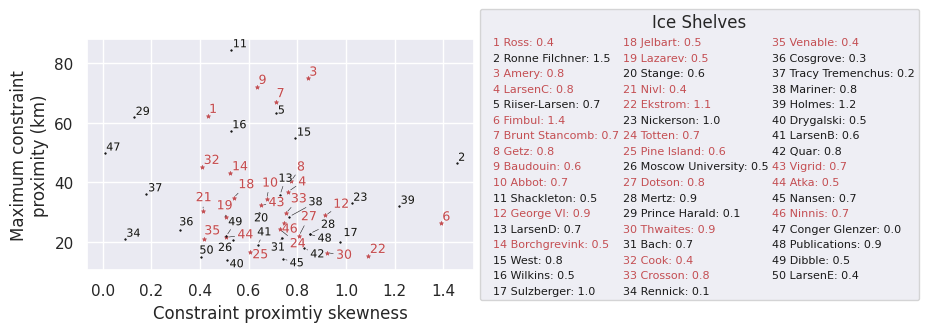

In [30]:
fig, ax = plt.subplots(figsize=(5, 3))

x='constraint_proximity_skewness'
y='max_constraint_distance'
# y="area_km"

# ax.plot(df[x], line, color='b')
# ax.fill_between(df[x], df.predict_lower, df.predict_upper, color='b', alpha=0.2)

df = ice_shelf_stats_gdf.sort_values("area_km", ascending=False)#.iloc[2:]

texts_a, texts_b = [], []
for ind, (_i, row) in enumerate(df.iterrows()):
    # plot inverted shelves as red stars and red labels
    if row.NAME in ice_shelf_stats.inverted_shelves:
        ax.scatter(
            x=row[x],
            y=row[y],
            color="r",
            marker="*",
            linewidths=.5,
            s=9,
            label=f"{ind+1} {row.NAME.replace('_', ' ')}: {round(row[x],1)}",
        )
        texts_a.append(
            ax.text(
                row[x],
                row[y],
                f"{ind+1}",
                fontsize=9,
                color="r",
                fontweight="normal",
                path_effects=[
                    patheffects.withStroke(linewidth=.5, foreground="white")
                ],
            )
        )
    else:
        ax.scatter(
            x=row[x],
            y=row[y],
            color="k",
            marker=".",
            s=5,
            linewidths=.5,
            label=f"{ind+1} {row.NAME.replace('_', ' ')}: {round(row[x],1)}",
        )
        texts_b.append(
            ax.text(
                row[x],
                row[y],
                f"{ind+1}",
                fontsize=8,
                color="k",
                fontweight="normal",
                path_effects=[
                    patheffects.withStroke(
                        linewidth=.5, foreground="white"
                    )
                ],
            )
        )
# auto adjust labels so they dont overlap
adjust_text(
    texts_a + texts_b,
    arrowprops=dict(arrowstyle="-", color="k", lw=0.4),
    ax=ax,
    expand=(1.2, 1.2),
    # force_text=(0,0),
    # force_static=(0,0),
)

ax.set_xlabel("Constraint proximtiy skewness")
ax.set_ylabel("Maximum constraint\nproximity (km)")

leg = ax.legend(
    title="Ice Shelves",
    title_fontproperties={'size': 12},
    loc="center left",
    bbox_to_anchor=(1, 0.5),
    # borderaxespad=6,
    # borderpad=-.5,
    handlelength=0,
    columnspacing=-0.5,
    markerscale=0,
    fontsize=8,
    ncol=3,
)
for handle, text in zip(leg.legend_handles, leg.get_texts()):
    text.set_color(handle.get_facecolor()[0])

# fig.savefig(
#     "../paper/figures/ice_shelves_max_vs_min_proximity.png",
#     bbox_inches="tight",
#     dpi=300,
# )

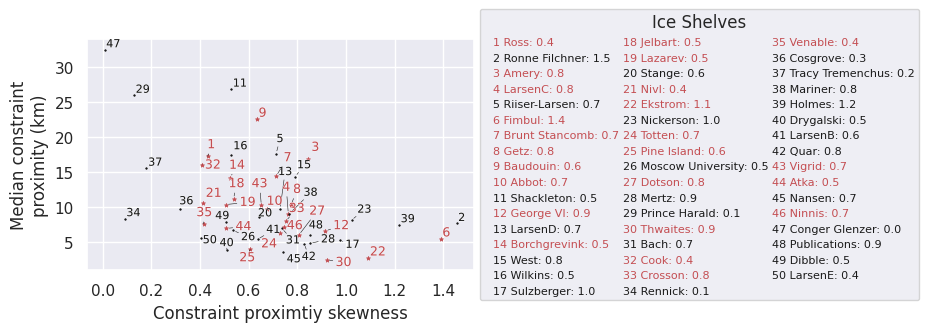

In [31]:
fig, ax = plt.subplots(figsize=(5, 3))

x='constraint_proximity_skewness'
y='median_constraint_distance'


# ax.plot(df[x], line, color='b')
# ax.fill_between(df[x], df.predict_lower, df.predict_upper, color='b', alpha=0.2)

df = ice_shelf_stats_gdf.sort_values("area_km", ascending=False)#.iloc[2:]

texts_a, texts_b = [], []
for ind, (_i, row) in enumerate(df.iterrows()):
    # plot inverted shelves as red stars and red labels
    if row.NAME in ice_shelf_stats.inverted_shelves:
        ax.scatter(
            x=row[x],
            y=row[y],
            color="r",
            marker="*",
            linewidths=.5,
            s=9,
            label=f"{ind+1} {row.NAME.replace('_', ' ')}: {round(row[x],1)}",
        )
        texts_a.append(
            ax.text(
                row[x],
                row[y],
                f"{ind+1}",
                fontsize=9,
                color="r",
                fontweight="normal",
                path_effects=[
                    patheffects.withStroke(linewidth=.5, foreground="white")
                ],
            )
        )
    else:
        ax.scatter(
            x=row[x],
            y=row[y],
            color="k",
            marker=".",
            s=5,
            linewidths=.5,
            label=f"{ind+1} {row.NAME.replace('_', ' ')}: {round(row[x],1)}",
        )
        texts_b.append(
            ax.text(
                row[x],
                row[y],
                f"{ind+1}",
                fontsize=8,
                color="k",
                fontweight="normal",
                path_effects=[
                    patheffects.withStroke(
                        linewidth=.5, foreground="white"
                    )
                ],
            )
        )
# auto adjust labels so they dont overlap
adjust_text(
    texts_a + texts_b,
    arrowprops=dict(arrowstyle="-", color="k", lw=0.4),
    ax=ax,
    expand=(1.2, 1.2),
    # force_text=(0,0),
    # force_static=(0,0),
)

ax.set_xlabel("Constraint proximtiy skewness")
ax.set_ylabel("Median constraint\nproximity (km)")

leg = ax.legend(
    title="Ice Shelves",
    title_fontproperties={'size': 12},
    loc="center left",
    bbox_to_anchor=(1, 0.5),
    # borderaxespad=6,
    # borderpad=-.5,
    handlelength=0,
    columnspacing=-0.5,
    markerscale=0,
    fontsize=8,
    ncol=3,
)
for handle, text in zip(leg.legend_handles, leg.get_texts()):
    text.set_color(handle.get_facecolor()[0])

# fig.savefig(
#     "../paper/figures/ice_shelves_max_vs_min_proximity.png",
#     bbox_inches="tight",
#     dpi=300,
# )

### For 3 parameters
#### Median proximity, TC-disturbance, estimated regional

In [28]:
# cols = [
#     'median_constraint_distance',
#     'topo_free_disturbance_stdev',
#     'reg_stdev',
#     # 'error_rms',
#     # "tc_dist_stdev_dist_stdev_ratio",

# ]
# titles = [
#     "Constraint proximity",
#     "$\delta g_{{TC}}$ stdev",
#     "Regional misfit stdev",
#     # "Gravity error RMS",
#     # "Ratio of $\delta g_{{TC}}$ stdev to $\delta g$ stdev",
# ]
# units = [
#     "km",
#     "mGal",
#     "mGal",
#     # "mGal",
#     # "",
# ]
# # df = ice_shelf_stats_gdf.iloc[0:80]
# df = ice_shelf_stats_gdf[ice_shelf_stats_gdf.area_km >1000]

# fig = sns.pairplot(
#     df[cols],
#     plot_kws={"s":1, "marker":"."},
#     diag_kws = {'bins':20},
#     height=2.3,
#     aspect=1.5
# )

# ax = fig.axes

# # update x and y axis titles
# for i, (r,c) in enumerate(itertools.product(range(len(cols)), range(len(cols)))):
#     if c == 0:
#         ax[r,c].set_ylabel(f"{titles[r]}\n({units[r]})")
#     if r == len(cols)-1:
#         ax[r,c].set_xlabel(f"{titles[c]}\n({units[c]})")

# # add boxes showing Ensemble extents
# constraint_spacing_lims = (2.521, 17.741)
# regional_stdev_lims = (4.091585, 40.915854)

# for axes in [ax[1,0], ax[2,0]]:
#     rect = mpl.patches.Rectangle(
#         (constraint_spacing_lims[0], regional_stdev_lims[0]), # lower left
#         constraint_spacing_lims[1]-constraint_spacing_lims[0], # width
#         regional_stdev_lims[1]-regional_stdev_lims[0], # height
#         linewidth=1,
#         edgecolor='b',
#         facecolor='none',
#     )
#     axes.add_patch(rect)
#     axes.scatter(
#         x=8.557, # median constraint proximity
#         y=4.0913, # regional stdev
#         marker="^",
#         color="b",
#         # label="Ensemble 2",
#         linewidth=1,
#         edgecolor='k',
#     )
#     axes.scatter(
#         x=8.557, # median constraint proximity
#         y=18.41093, # regional stdev
#         marker="^",
#         color="b",
#         # label="Ensemble 3",
#         linewidth=1,
#         edgecolor='k',
#     )
#     axes.scatter(
#         x=8.557, # median constraint proximity
#         y=40.91585, # regional stdev
#         marker="^",
#         color="b",
#         # label="Ensemble 4",
#         linewidth=1,
#         edgecolor='k',
#     )

# for axes in [ax[0,1], ax[0,2]]:
#     rect = mpl.patches.Rectangle(
#         (regional_stdev_lims[0], constraint_spacing_lims[0]), # lower left
#         regional_stdev_lims[1]-regional_stdev_lims[0], # width
#         constraint_spacing_lims[1]-constraint_spacing_lims[0], # height
#         linewidth=1,
#         edgecolor='b',
#         facecolor='none',
#     )
#     axes.add_patch(rect)
#     axes.scatter(
#         y=8.557, # median constraint proximity
#         x=4.0913, # regional stdev
#         marker="^",
#         color="b",
#         linewidth=1,
#         edgecolor='k',
#     )
#     axes.scatter(
#         y=8.557, # median constraint proximity
#         x=18.41093, # regional stdev
#         marker="^",
#         color="b",
#         linewidth=1,
#         edgecolor='k',
#     )
#     axes.scatter(
#         y=8.557, # median constraint proximity
#         x=40.91585, # regional stdev
#         marker="^",
#         color="b",
#         linewidth=1,
#         edgecolor='k',
#     )

# for axes in [ax[1,2], ax[2,1]]:
#     axes.scatter(
#         y=4.0913, # regional stdev
#         x=4.0913, # regional stdev
#         marker="^",
#         color="b",
#         linewidth=1,
#         edgecolor='k',
#     )
#     axes.scatter(
#         y=18.41093, # regional stdev
#         x=18.41093, # regional stdev
#         marker="^",
#         color="b",
#         linewidth=1,
#         edgecolor='k',
#     )
#     axes.scatter(
#         y=40.91585, # regional stdev
#         x=40.91585, # regional stdev
#         marker="^",
#         color="b",
#         linewidth=1,
#         edgecolor='k',
#     )

# # add mean and median lines and labels
# for i in range(len(cols)):
#     mean = round(df[cols[i]].mean())
#     ax[i,i].axvline(
#         mean,
#         color='r',
#         linestyle='dashed',
#         linewidth=2,
#         label=f'mean: {mean} {units[i]}')
#     median = round(df[cols[i]].median())
#     ax[i,i].axvline(
#         median,
#         color='g',
#         linestyle='dashed',
#         linewidth=2,
#         label=f'median: {median} {units[i]}')
#     ax[i,i].legend(fontsize='small')

# # add subplot labels
# for i, (r,c) in enumerate(itertools.product(range(len(cols)), range(len(cols)))):
#     ax[r,c].annotate(
#         f"{string.ascii_lowercase[i+2]})",
#         # (0.34, 0.94),
#         (0, .92),
#         xycoords='axes fraction',
#         fontsize=16,
#         # bbox=dict(boxstyle='round,pad=0.1', alpha=0.5),

#     )

# import itertools
# for i, (r,c) in enumerate(itertools.product(range(len(cols)), range(len(cols)))):
#     if r == c:
#         continue
#     # add largest shelves to plot with labels
#     texts_a = []
#     texts_b = []

#     # add symbols to legend
#     if (r,c) == (1,0):
#         ax[r, c].scatter(
#             [],[],
#             color="r",
#             marker="*",
#             linewidths=.5,
#             s=11,
#             label="previously inverted",
#         )
#         ax[r, c].scatter(
#             [],[],
#             color="k",
#             marker=".",
#             s=7,
#             linewidths=.5,
#             label="50 largest",
#         )
#         ax[r, c].scatter(
#             [],[],
#             marker="^",
#             color="b",
#             linewidth=1,
#             edgecolor='k',
#             label="Ensembles 2-4 values",
#         )

#         # Get existing handles and labels.
#         handles, labels = ax[r, c].get_legend_handles_labels()

#         handles.insert(2, rect)
#         labels.insert(2, "Ensemble 1 values")

#         ax[r, c].legend(
#             handles, labels,
#             fontsize='x-small',
#             labelspacing=0.2,
#             handletextpad=0.2,
#             borderpad=0.2,
#             borderaxespad=0.1,
#         )

#     for ind, (_i, row) in enumerate(df.iterrows()):
#         # plot inverted shelves as red stars and red labels
#         if row.NAME in ice_shelf_stats.inverted_shelves:
#             ax[r, c].scatter(
#                 x=row[cols[c]],
#                 y=row[cols[r]],
#                 color="r",
#                 marker="*",
#                 linewidths=.5,
#                 s=9,
#                 label=f"{ind+1} {row.NAME.replace('_', ' ')}",
#             )
#             texts_a.append(
#                 ax[r, c].text(
#                     row[cols[c]],
#                     row[cols[r]],
#                     f"{ind+1}",
#                     fontsize=8,
#                     color="r",
#                     fontweight="normal",
#                     path_effects=[
#                         patheffects.withStroke(linewidth=.5, foreground="white")
#                     ],
#                 )
#             )
#         else:
#             ax[r, c].scatter(
#                 x=row[cols[c]],
#                 y=row[cols[r]],
#                 color="k",
#                 marker=".",
#                 s=5,
#                 linewidths=.5,
#                 label=f"{ind+1} {row.NAME.replace('_', ' ')}",
#             )
#             texts_b.append(
#                 ax[r, c].text(
#                     row[cols[c]],
#                     row[cols[r]],
#                     f"{ind+1}",
#                     fontsize=6,
#                     color="k",
#                     fontweight="normal",
#                     path_effects=[
#                         patheffects.withStroke(
#                             linewidth=.5, foreground="white"
#                         )
#                     ],
#                 )
#             )
#     # auto adjust labels so they dont overlap
#     adjust_text(
#         texts_a + texts_b,
#         arrowprops=dict(arrowstyle="-", color="k", lw=0.4),
#         ax=ax[r, c],
#         expand=(1.2, 1.2),
#         # force_text=(0,0),
#         # force_static=(0,0),
#     )


# # fig.savefig(
# #     "../paper/figures/Antarctic_correlations.png",
# #     bbox_inches="tight",
# #     dpi=500,
# # )

# for col in cols:
#     print(
#         f"{col}:\n\t"
#         f"min: {df[col].min()}\n\t"
#         f"max: {df[col].max()}\n\t"
#         f"mean: {df[col].mean()}\n\t"
#         f"median: {df[col].median()}\n\t"
#         f"std: {df[col].std()}"
#     )

In [29]:
# leg = ax[1,2].legend(
#     title="Ice Shelves",
#     title_fontproperties={'size': 14},
#     loc="center left",
#     bbox_to_anchor=(1, 0.5),
#     # borderaxespad=6,
#     # borderpad=-.5,
#     handlelength=0,
#     columnspacing=-0.5,
#     markerscale=0,
#     fontsize=12,
#     ncol=2,
# )
# for handle, text in zip(leg.legend_handles, leg.get_texts()):
#     text.set_color(handle.get_facecolor()[0])

# fig.savefig(
#     "../paper/figures/Antarctic_correlations.png",
#     bbox_inches="tight",
#     dpi=400,
# )

# fig.fig

### For 2 parameters

Text(400.0568181818181, 0.5, '$\\delta g_{{TC}}$ stdev (mGal)')

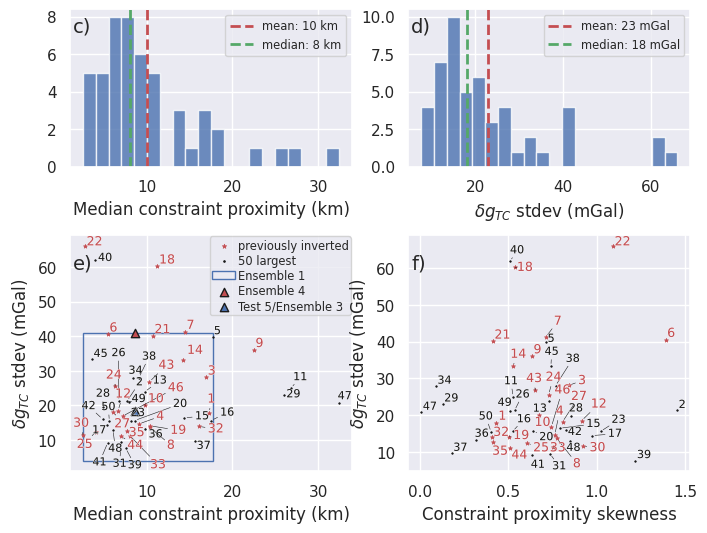

In [53]:
df = ice_shelf_stats_gdf

from matplotlib.gridspec import GridSpec

fig = plt.figure(
    # layout="constrained",
    # constrained_layout=False,

    figsize=(8,6),
)

gs = GridSpec(
    2, 2,
    figure=fig,
    height_ratios=[1,1.5],
    hspace=0.35,
    wspace=0.2,
    # bottom=0.3,
    # left=0.02,
    # right=0.95,
)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[1, 0])
ax4 = fig.add_subplot(gs[1, 1])

# fig, axes = plt.subplots(
#     nrows=2,
#     ncols=2,
#     figsize=(8, 7),
# )

###
###
# Histogram 1
###
###
ax1.annotate(
    f"c)",
    (0.01, .86),
    xycoords='axes fraction',
    fontsize=14,
    # bbox=dict(boxstyle='round,pad=0.1', alpha=0.5),
)
ax1.hist(
    df.median_constraint_distance,
    bins=20,
    alpha=.8,
)
mean = round(df.median_constraint_distance.mean())
ax1.axvline(
    mean,
    color='r',
    linestyle='dashed',
    linewidth=2,
    label=f'mean: {mean} km')
median = round(df.median_constraint_distance.median())
ax1.axvline(
    median,
    color='g',
    linestyle='dashed',
    linewidth=2,
    label=f'median: {median} km')
ax1.legend(fontsize='x-small')

ax1.set_xlabel("Median constraint proximity (km)")
ax1.set_ylabel(None)

###
###
# Histogram 2
###
###
ax2.annotate(
    f"d)",
    (0.01, .86),
    xycoords='axes fraction',
    fontsize=14,
    # bbox=dict(boxstyle='round,pad=0.1', alpha=0.5),
)
ax2.hist(
    df.topo_free_disturbance_stdev,
    bins=20,
    alpha=.8,
)
mean = round(df.topo_free_disturbance_stdev.mean())
ax2.axvline(
    mean,
    color='r',
    linestyle='dashed',
    linewidth=2,
    label=f'mean: {mean} mGal')
median = round(df.topo_free_disturbance_stdev.median())
ax2.axvline(
    median,
    color='g',
    linestyle='dashed',
    linewidth=2,
    label=f'median: {median} mGal')
ax2.legend(fontsize='x-small')


ax2.set_xlabel("$\delta g_{{TC}}$ stdev (mGal)")
ax2.set_ylabel(None)

###
###
# Scatterplot 1
###
###
ax3.annotate(
    f"e)",
    (0.01, .86),
    xycoords='axes fraction',
    fontsize=14,
    # bbox=dict(boxstyle='round,pad=0.1', alpha=0.5),
)
x='median_constraint_distance'
y='topo_free_disturbance_stdev'

# add boxes showing Ensemble extents
constraint_spacing_lims = (2.521, 17.741)
regional_stdev_lims = (4.091585, 40.915854)

rect = mpl.patches.Rectangle(
        (constraint_spacing_lims[0], regional_stdev_lims[0]), # lower left
        constraint_spacing_lims[1]-constraint_spacing_lims[0], # width
        regional_stdev_lims[1]-regional_stdev_lims[0], # height
        linewidth=1,
        edgecolor='b',
        facecolor='none',
    )
ax3.add_patch(rect)
ax3.scatter(
    x=8.557, # median constraint proximity
    y=18.41093, # regional stdev
    marker="^",
    color="b",
    # label="Ensemble 3",
    linewidth=1,
    edgecolor='k',
)
ax3.scatter(
    x=8.557, # median constraint proximity
    y=40.91585, # regional stdev
    marker="^",
    color="r",
    # label="Ensemble 4",
    linewidth=1,
    edgecolor='k',
)

ax3.scatter(
    [],[],
    color="r",
    marker="*",
    linewidths=.5,
    s=11,
    label="previously inverted",
)
ax3.scatter(
    [],[],
    color="k",
    marker=".",
    s=7,
    linewidths=.5,
    label="50 largest",
)
ax3.scatter(
    [],[],
    marker="^",
    color="r",
    linewidth=1,
    edgecolor='k',
    label="Ensemble 4",
)
ax3.scatter(
    [],[],
    marker="^",
    color="b",
    linewidth=1,
    edgecolor='k',
    label="Test 5/Ensemble 3",
)

# Get existing handles and labels.
handles, labels = ax3.get_legend_handles_labels()

handles.insert(2, rect)
labels.insert(2, "Ensemble 1")

ax3.legend(
    handles, labels,
    fontsize='x-small',
    labelspacing=0.2,
    handletextpad=0.2,
    borderpad=0.2,
    borderaxespad=0.1,
)

texts_a, texts_b = [], []
for ind, (_i, row) in enumerate(df.iterrows()):
    # plot inverted shelves as red stars and red labels
    if row.NAME in ice_shelf_stats.inverted_shelves:
        ax3.scatter(
            x=row[x],
            y=row[y],
            color="r",
            marker="*",
            linewidths=.5,
            s=9,
            label=f"{ind+1} {row.NAME.replace('_', ' ')}: {round(row[x],1)}",
        )
        texts_a.append(
            ax3.text(
                row[x],
                row[y],
                f"{ind+1}",
                fontsize=9,
                color="r",
                fontweight="normal",
                path_effects=[
                    patheffects.withStroke(linewidth=.5, foreground="white")
                ],
            )
        )
    else:
        ax3.scatter(
            x=row[x],
            y=row[y],
            color="k",
            marker=".",
            s=5,
            linewidths=.5,
            label=f"{ind+1} {row.NAME.replace('_', ' ')}: {round(row[x],1)}",
        )
        texts_b.append(
            ax3.text(
                row[x],
                row[y],
                f"{ind+1}",
                fontsize=8,
                color="k",
                fontweight="normal",
                path_effects=[
                    patheffects.withStroke(
                        linewidth=.5, foreground="white"
                    )
                ],
            )
        )

# auto adjust labels so they dont overlap
adjust_text(
    texts_a + texts_b,
    arrowprops=dict(arrowstyle="-", color="k", lw=0.4),
    ax=ax3,
    expand=(1.2, 1.2),
)

ax3.set_xlabel("Median constraint proximity (km)")
ax3.set_ylabel("$\delta g_{{TC}}$ stdev (mGal)")


###
###
# Scatterplot 2
###
###
ax4.annotate(
    f"f)",
    (0.01, .86),
    xycoords='axes fraction',
    fontsize=14,
    # bbox=dict(boxstyle='round,pad=0.1', alpha=0.5),
)

# # add boxes showing Ensemble extents
# skewness_lims = (-0.144477, 0.483691)
# regional_stdev_lims = (4.091585, 40.915854)

# rect = mpl.patches.Rectangle(
#         (skewness_lims[0], regional_stdev_lims[0]), # lower left
#         skewness_lims[1]-skewness_lims[0], # width
#         regional_stdev_lims[1]-regional_stdev_lims[0], # height
#         linewidth=1,
#         edgecolor='b',
#         facecolor='none',
#     )
# ax4.add_patch(rect)

# ax4.scatter(
#     x=0.0043, # skewness
#     y=18.41093, # tc_dist stdev
#     marker="^",
#     color="b",
#     linewidth=1,
#     edgecolor='k',
#     label="Test 5/Ensembles 2-4",
# )
# # ax4.scatter(
# #     [],[],
# #     marker="^",
# #     color="b",
# #     linewidth=1,
# #     edgecolor='k',
# #     label="Test 5/Ensembles 2-4",
# # )
# # Get existing handles and labels.
# handles, labels = ax4.get_legend_handles_labels()

# ax4.legend(
#     handles, labels,
#     fontsize='x-small',
#     labelspacing=0.2,
#     handletextpad=0.2,
#     borderpad=0.2,
#     borderaxespad=0.1,
# )
# for artist in ax4.lines + ax4.collections + ax4.patches + ax4.images:
#     artist.set_label(None)

x='constraint_proximity_skewness'
# y='max_constraint_distance'
y='topo_free_disturbance_stdev'

texts_a, texts_b = [], []
for ind, (_i, row) in enumerate(df.iterrows()):
    # plot inverted shelves as red stars and red labels
    if row.NAME in ice_shelf_stats.inverted_shelves:
        ax4.scatter(
            x=row[x],
            y=row[y],
            color="r",
            marker="*",
            linewidths=.5,
            s=9,
            label=f"{ind+1} {row.NAME.replace('_', ' ')}",#: {round(row[x],1)}",
        )
        texts_a.append(
            ax4.text(
                row[x],
                row[y],
                f"{ind+1}",
                fontsize=9,
                color="r",
                fontweight="normal",
                path_effects=[
                    patheffects.withStroke(linewidth=.5, foreground="white")
                ],
            )
        )
    else:
        ax4.scatter(
            x=row[x],
            y=row[y],
            color="k",
            marker=".",
            s=5,
            linewidths=.5,
            label=f"{ind+1} {row.NAME.replace('_', ' ')}",#: {round(row[x],1)}",
        )
        texts_b.append(
            ax4.text(
                row[x],
                row[y],
                f"{ind+1}",
                fontsize=8,
                color="k",
                fontweight="normal",
                path_effects=[
                    patheffects.withStroke(
                        linewidth=.5, foreground="white"
                    )
                ],
            )
        )

# auto adjust labels so they dont overlap
adjust_text(
    texts_a + texts_b,
    arrowprops=dict(arrowstyle="-", color="k", lw=0.4),
    ax=ax4,
    expand=(1.2, 1.2),
)

ax4.set_xlabel("Constraint proximity skewness")
# ax4.set_ylabel("Max constraint proximity (km)")
ax4.set_ylabel("$\delta g_{{TC}}$ stdev (mGal)")


# leg = ax.legend(
#     title="Ice Shelves",
#     title_fontproperties={'size': 12},
#     loc="center left",
#     bbox_to_anchor=(1, 0.5),
#     # borderaxespad=6,
#     # borderpad=-.5,
#     handlelength=0,
#     columnspacing=-0.5,
#     markerscale=0,
#     fontsize=8,
#     ncol=3,
# )
# for handle, text in zip(leg.legend_handles, leg.get_texts()):
    # text.set_color(handle.get_facecolor()[0])

# plt.tight_layout()

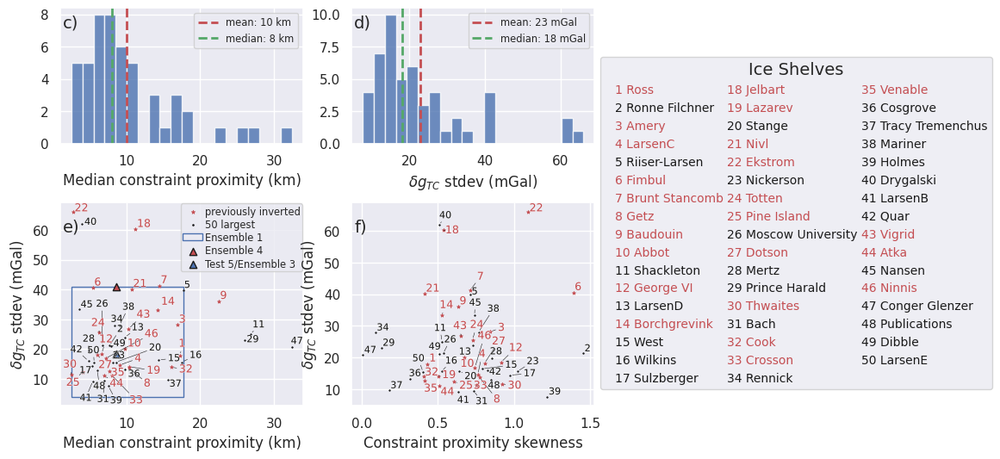

In [54]:
leg = ax4.legend(
    title="Ice Shelves",
    title_fontproperties={'size': 14},
    loc="center left",
    bbox_to_anchor=(1, .9),
    # borderaxespad=6,
    # borderpad=-.5,
    handlelength=0,
    columnspacing=-0.5,
    markerscale=0,
    fontsize=10,
    ncol=3,
)
for handle, text in zip(leg.legend_handles, leg.get_texts()):
    text.set_color(handle.get_facecolor()[0])

fig.savefig(
    "../paper/figures/Antarctic_correlations.png",
    bbox_inches="tight",
    dpi=400,
)

fig

In [32]:
# cols = [
#     'median_constraint_distance',
#     'topo_free_disturbance_stdev',
# ]
# titles = [
#     "Median constraint\n proximity (km)",
#     "$\delta g_{{TC}}$ stdev\n (mGal)",
# ]
# units = [
#     "km",
#     "mGal",
# ]
# # df = ice_shelf_stats_gdf.iloc[0:50]
# df = ice_shelf_stats_gdf[ice_shelf_stats_gdf.area_km >1000]

# fig = sns.pairplot(
#     df[cols],
#     plot_kws={"s":1, "marker":"."},
#     diag_kws = {'bins':20},
#     height=2.3,
#     aspect=1.5
# )

# ax = fig.axes

# # update x and y axis titles
# for i, (r,c) in enumerate(itertools.product(range(len(cols)), range(len(cols)))):
#     if c == 0:
#         ax[r,c].set_ylabel(f"{titles[r]}")
#     if r == len(cols)-1:
#         ax[r,c].set_xlabel(f"{titles[c]}")

# # add boxes showing Ensemble extents
# constraint_spacing_lims = (2.521, 17.741)
# regional_stdev_lims = (4.091585, 40.915854)

# for axes in [ax[1,0]]:
#     rect = mpl.patches.Rectangle(
#         (constraint_spacing_lims[0], regional_stdev_lims[0]), # lower left
#         constraint_spacing_lims[1]-constraint_spacing_lims[0], # width
#         regional_stdev_lims[1]-regional_stdev_lims[0], # height
#         linewidth=1,
#         edgecolor='b',
#         facecolor='none',
#     )
#     axes.add_patch(rect)
#     axes.scatter(
#         x=8.557, # median constraint proximity
#         y=4.0913, # regional stdev
#         marker="^",
#         color="b",
#         # label="Ensemble 2",
#         linewidth=1,
#         edgecolor='k',
#     )
#     axes.scatter(
#         x=8.557, # median constraint proximity
#         y=18.41093, # regional stdev
#         marker="^",
#         color="b",
#         # label="Ensemble 3",
#         linewidth=1,
#         edgecolor='k',
#     )
#     axes.scatter(
#         x=8.557, # median constraint proximity
#         y=40.91585, # regional stdev
#         marker="^",
#         color="b",
#         # label="Ensemble 4",
#         linewidth=1,
#         edgecolor='k',
#     )

# for axes in [ax[0,1]]:
#     rect = mpl.patches.Rectangle(
#         (regional_stdev_lims[0], constraint_spacing_lims[0]), # lower left
#         regional_stdev_lims[1]-regional_stdev_lims[0], # width
#         constraint_spacing_lims[1]-constraint_spacing_lims[0], # height
#         linewidth=1,
#         edgecolor='b',
#         facecolor='none',
#     )
#     axes.add_patch(rect)
#     axes.scatter(
#         y=8.557, # median constraint proximity
#         x=4.0913, # regional stdev
#         marker="^",
#         color="b",
#         linewidth=1,
#         edgecolor='k',
#     )
#     axes.scatter(
#         y=8.557, # median constraint proximity
#         x=18.41093, # regional stdev
#         marker="^",
#         color="b",
#         linewidth=1,
#         edgecolor='k',
#     )
#     axes.scatter(
#         y=8.557, # median constraint proximity
#         x=40.91585, # regional stdev
#         marker="^",
#         color="b",
#         linewidth=1,
#         edgecolor='k',
#     )

# # add mean and median lines and labels
# for i in range(len(cols)):
#     mean = round(df[cols[i]].mean())
#     ax[i,i].axvline(
#         mean,
#         color='r',
#         linestyle='dashed',
#         linewidth=2,
#         label=f'mean: {mean} {units[i]}')
#     median = round(df[cols[i]].median())
#     ax[i,i].axvline(
#         median,
#         color='g',
#         linestyle='dashed',
#         linewidth=2,
#         label=f'median: {median} {units[i]}')
#     ax[i,i].legend(fontsize='small')

# # add subplot labels
# for i, (r,c) in enumerate(itertools.product(range(len(cols)), range(len(cols)))):
#     ax[r,c].annotate(
#         f"{string.ascii_lowercase[i+2]})",
#         (0.01, .86),
#         xycoords='axes fraction',
#         fontsize=14,
#         # bbox=dict(boxstyle='round,pad=0.1', alpha=0.5),
#     )

# import itertools
# for i, (r,c) in enumerate(itertools.product(range(len(cols)), range(len(cols)))):
#     if r == c:
#         continue
#     # add largest shelves to plot with labels
#     texts_a = []
#     texts_b = []

#     # add symbols to legend
#     if (r,c) == (1,0):
#         ax[r, c].scatter(
#             [],[],
#             color="r",
#             marker="*",
#             linewidths=.5,
#             s=11,
#             label="previously inverted",
#         )
#         ax[r, c].scatter(
#             [],[],
#             color="k",
#             marker=".",
#             s=7,
#             linewidths=.5,
#             label="50 largest",
#         )
#         ax[r, c].scatter(
#             [],[],
#             marker="^",
#             color="b",
#             linewidth=1,
#             edgecolor='k',
#             label="Ensembles 2-4",
#         )

#         # Get existing handles and labels.
#         handles, labels = ax[r, c].get_legend_handles_labels()

#         handles.insert(2, rect)
#         labels.insert(2, "Ensemble 1")

#         ax[r, c].legend(
#             handles, labels,
#             fontsize='x-small',
#             labelspacing=0.2,
#             handletextpad=0.2,
#             borderpad=0.2,
#             borderaxespad=0.1,
#         )

#     for ind, (_i, row) in enumerate(df.iterrows()):
#         # plot inverted shelves as red stars and red labels
#         if row.NAME in ice_shelf_stats.inverted_shelves:
#             ax[r, c].scatter(
#                 x=row[cols[c]],
#                 y=row[cols[r]],
#                 color="r",
#                 marker="*",
#                 linewidths=.5,
#                 s=9,
#                 label=f"{ind+1} {row.NAME.replace('_', ' ')}",
#             )
#             texts_a.append(
#                 ax[r, c].text(
#                     row[cols[c]],
#                     row[cols[r]],
#                     f"{ind+1}",
#                     fontsize=8,
#                     color="r",
#                     fontweight="normal",
#                     path_effects=[
#                         patheffects.withStroke(linewidth=.5, foreground="white")
#                     ],
#                 )
#             )
#         else:
#             ax[r, c].scatter(
#                 x=row[cols[c]],
#                 y=row[cols[r]],
#                 color="k",
#                 marker=".",
#                 s=5,
#                 linewidths=.5,
#                 label=f"{ind+1} {row.NAME.replace('_', ' ')}",
#             )
#             texts_b.append(
#                 ax[r, c].text(
#                     row[cols[c]],
#                     row[cols[r]],
#                     f"{ind+1}",
#                     fontsize=7,
#                     color="k",
#                     fontweight="normal",
#                     path_effects=[
#                         patheffects.withStroke(
#                             linewidth=.5, foreground="white"
#                         )
#                     ],
#                 )
#             )
#     # auto adjust labels so they dont overlap
#     adjust_text(
#         texts_a + texts_b,
#         arrowprops=dict(arrowstyle="-", color="k", lw=0.4),
#         ax=ax[r, c],
#         expand=(1.2, 1.2),
#         # force_text=(0,0),
#         # force_static=(0,0),
#     )

# for col in cols:
#     print(
#         f"{col}:\n\t"
#         f"min: {df[col].min()}\n\t"
#         f"max: {df[col].max()}\n\t"
#         f"mean: {df[col].mean()}\n\t"
#         f"median: {df[col].median()}\n\t"
#         f"std: {df[col].std()}"
#     )

In [33]:
# leg = ax[0,1].legend(
#     title="Ice Shelves",
#     title_fontproperties={'size': 14},
#     loc="center left",
#     bbox_to_anchor=(1, 0),
#     # borderaxespad=6,
#     # borderpad=-.5,
#     handlelength=0,
#     columnspacing=-0.5,
#     markerscale=0,
#     fontsize=10,
#     ncol=3,
# )
# for handle, text in zip(leg.legend_handles, leg.get_texts()):
#     text.set_color(handle.get_facecolor()[0])

# fig.savefig(
#     "../paper/figures/Antarctic_correlations.png",
#     bbox_inches="tight",
#     dpi=400,
# )

# fig.fig

## Add constraint to shelves

In [28]:
# # for a range of ice shelves
# ice_shelf_added_constraints = ice_shelf_stats.add_single_constraint(
#     ice_shelf_stats_gdf,
#     file_path="../results/ice_shelves/",
#     spacing=100,
#     buffer=20e3,
# )
# ice_shelf_added_constraints

In [ ]:
# ice_shelf_added_constraints.to_csv("../results/ice_shelves/ice_shelf_gravity_stats_added_constraint.csv", index=False,)

In [4]:
ice_shelf_added_constraints = pd.read_csv("../results/ice_shelves/ice_shelf_gravity_stats_added_constraint.csv", index_col=None)

# turn back into geodataframe
ice_shelf_added_constraints = gpd.GeoDataFrame(
    ice_shelf_added_constraints,
    geometry=gpd.GeoSeries.from_wkt(ice_shelf_added_constraints['geometry'], crs="EPSG:3031"),
    crs="EPSG:3031",
)

ice_shelf_added_constraints

,NAME,Regions,TYPE,geometry,area_km,median_constraint_distance,mean_constraint_distance,max_constraint_distance,constraint_proximity_skewness,gravity_disturbance_rms,...,res_stdev,error_rms,error_stdev,residual_constraint_proximity_ratio_rms,residual_constraint_proximity_ratio_stdev,regional_constraint_proximity_ratio_rms,regional_constraint_proximity_ratio_stdev,updated_median_constraint_distance,median_proximity_change,percent_median_proximity_change
0,Ross,West,FL,"POLYGON ((-240677.184 -678259.006, -240038.274...",480428.37,17.282824,17.636882,62.339089,0.431810,44.934094,...,5.931834,12.748633,3.154937,129.988110,129.983190,306.318730,291.707559,17.232338,0.050486,0.292117
1,Ronne_Filchner,West,FL,"POLYGON ((-1006734.891 880592.980, -1006335.92...",427041.70,7.686515,8.739788,46.338298,1.456174,41.514238,...,3.955927,7.952294,1.760702,59.403593,59.405243,350.428117,251.256955,7.680386,0.006128,0.079730
2,Amery,East,FL,"POLYGON ((2134701.422 618463.117, 2131452.011 ...",60797.28,16.941666,21.373582,74.852666,0.844014,54.656450,...,12.592517,8.432001,0.497149,504.180788,443.561742,1176.362259,869.215104,16.374142,0.567524,3.349870
3,LarsenC,Peninsula,FL,"POLYGON ((-2235724.269 1271352.188, -2235828.5...",47443.51,9.067471,10.260593,36.855613,0.763313,14.824574,...,5.084219,5.735885,1.390208,69.270786,69.137847,509.713990,330.660555,8.970575,0.096897,1.068617
4,Riiser-Larsen,East,FL,"POLYGON ((-592166.317 1592824.258, -593783.160...",42913.14,17.664812,20.596557,63.202992,0.713248,53.556828,...,12.025394,8.285409,0.728764,448.277737,435.945629,2026.638735,1361.039287,16.920875,0.743937,4.211407
5,Fimbul,East,FL,"POLYGON ((145423.961 2176737.792, 145088.314 2...",40947.75,5.450097,6.460643,26.199066,1.391103,55.666475,...,8.292620,6.037483,1.283386,109.233174,105.179714,650.592081,427.162707,5.432545,0.017552,0.322051
6,Brunt_Stancomb,East,FL,"POLYGON ((-648673.952 1612385.898, -648144.200...",36137.10,14.462157,18.965093,66.878832,0.713434,31.663309,...,14.013457,5.764394,2.020729,449.637678,399.008397,1177.032382,828.056156,13.506528,0.955630,6.607795
7,Getz,West,FL,"MULTIPOLYGON (((-1464395.442 -1011065.611, -14...",33389.04,10.337270,11.505782,40.419329,0.774685,45.815742,...,11.769703,6.840661,2.799637,291.644600,226.454433,143.686027,113.164656,10.146531,0.190739,1.845161
8,Baudouin,East,FL,"POLYGON ((894980.201 1963931.580, 894465.744 1...",33129.24,22.523870,24.018180,72.093600,0.635214,37.878304,...,16.700756,7.175396,1.815555,848.553293,726.514827,1652.047369,1314.374220,20.907322,1.616548,7.177044
9,Abbot,West,FL,"MULTIPOLYGON (((-1946681.999 -330470.661, -194...",31389.73,9.786923,10.943510,34.300815,0.673908,28.653549,...,17.028213,6.650965,1.750310,344.822224,276.024068,321.903313,225.748172,9.617116,0.169807,1.735043


In [5]:
ice_shelf_added_constraints.sort_values("median_proximity_change")[[
    "NAME",
    "constraint_proximity_skewness",
    "percent_median_proximity_change",
    "median_proximity_change",
    "median_constraint_distance",
    "updated_median_constraint_distance",
]]

,NAME,constraint_proximity_skewness,percent_median_proximity_change,median_proximity_change,median_constraint_distance,updated_median_constraint_distance
1,Ronne_Filchner,1.456174,0.079730,0.006128,7.686515,7.680386
5,Fimbul,1.391103,0.322051,0.017552,5.450097,5.432545
21,Ekstrom,1.091623,0.800631,0.021885,2.733504,2.711619
16,Sulzberger,0.974902,0.562860,0.029785,5.291712,5.261927
0,Ross,0.431810,0.292117,0.050486,17.282824,17.232338
29,Thwaites,0.921421,2.053345,0.051631,2.514499,2.462868
24,Pine_Island,0.606235,1.727453,0.068830,3.984452,3.915623
11,George_VI,0.916105,1.177472,0.078061,6.629541,6.551480
3,LarsenC,0.763313,1.068617,0.096897,9.067471,8.970575
12,LarsenD,0.729375,1.191511,0.116142,9.747474,9.631332


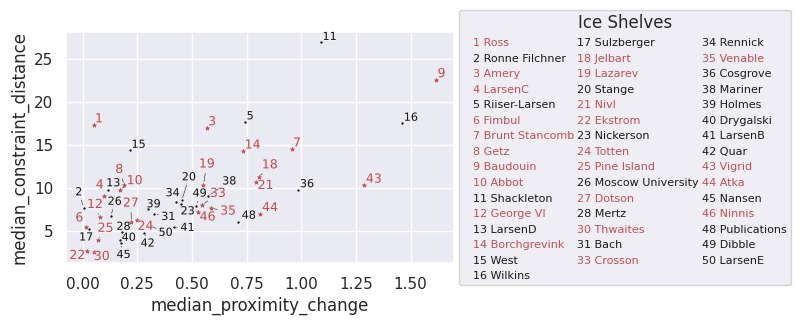

In [32]:
fig, ax = plt.subplots(figsize=(5, 3))

x='median_proximity_change'
y='median_constraint_distance'

df = ice_shelf_added_constraints

df = df[df[x]<2]

texts_a, texts_b = [], []
for _i, row in df.iterrows():
    row_index = row.name+1
    # plot inverted shelves as red stars and red labels
    if row.NAME in ice_shelf_stats.inverted_shelves:
        ax.scatter(
            x=row[x],
            y=row[y],
            color="r",
            marker="*",
            linewidths=.5,
            s=9,
            label=f"{row_index} {row.NAME.replace('_', ' ')}",
        )
        texts_a.append(
            ax.text(
                row[x],
                row[y],
                f"{row_index}",
                fontsize=9,
                color="r",
                fontweight="normal",
                path_effects=[
                    patheffects.withStroke(linewidth=.5, foreground="white")
                ],
            )
        )
    else:
        ax.scatter(
            x=row[x],
            y=row[y],
            color="k",
            marker=".",
            s=5,
            linewidths=.5,
            label=f"{row_index} {row.NAME.replace('_', ' ')}",
        )
        texts_b.append(
            ax.text(
                row[x],
                row[y],
                f"{row_index}",
                fontsize=8,
                color="k",
                fontweight="normal",
                path_effects=[
                    patheffects.withStroke(
                        linewidth=.5, foreground="white"
                    )
                ],
            )
        )
# auto adjust labels so they dont overlap
adjust_text(
    texts_a + texts_b,
    arrowprops=dict(arrowstyle="-", color="k", lw=0.4),
    ax=ax,
    expand=(1.2, 1.2),
)

ax.set_xlabel(x)
ax.set_ylabel(y)

leg = ax.legend(
    title="Ice Shelves",
    title_fontproperties={'size': 12},
    loc="center left",
    bbox_to_anchor=(1, 0.5),
    handlelength=0,
    columnspacing=-0.5,
    markerscale=0,
    fontsize=8,
    ncol=3,
)
for handle, text in zip(leg.legend_handles, leg.get_texts()):
    text.set_color(handle.get_facecolor()[0])

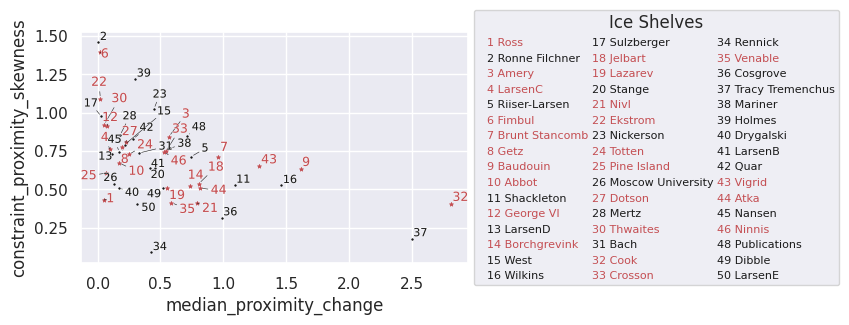

In [34]:
fig, ax = plt.subplots(figsize=(5, 3))

x='median_proximity_change'
y='constraint_proximity_skewness'

df = ice_shelf_added_constraints

df = df[df[x]<3]

texts_a, texts_b = [], []
for _i, row in df.iterrows():
    row_index = row.name+1
    # plot inverted shelves as red stars and red labels
    if row.NAME in ice_shelf_stats.inverted_shelves:
        ax.scatter(
            x=row[x],
            y=row[y],
            color="r",
            marker="*",
            linewidths=.5,
            s=9,
            label=f"{row_index} {row.NAME.replace('_', ' ')}",
        )
        texts_a.append(
            ax.text(
                row[x],
                row[y],
                f"{row_index}",
                fontsize=9,
                color="r",
                fontweight="normal",
                path_effects=[
                    patheffects.withStroke(linewidth=.5, foreground="white")
                ],
            )
        )
    else:
        ax.scatter(
            x=row[x],
            y=row[y],
            color="k",
            marker=".",
            s=5,
            linewidths=.5,
            label=f"{row_index} {row.NAME.replace('_', ' ')}",
        )
        texts_b.append(
            ax.text(
                row[x],
                row[y],
                f"{row_index}",
                fontsize=8,
                color="k",
                fontweight="normal",
                path_effects=[
                    patheffects.withStroke(
                        linewidth=.5, foreground="white"
                    )
                ],
            )
        )
# auto adjust labels so they dont overlap
adjust_text(
    texts_a + texts_b,
    arrowprops=dict(arrowstyle="-", color="k", lw=0.4),
    ax=ax,
    expand=(1.2, 1.2),
)

ax.set_xlabel(x)
ax.set_ylabel(y)

leg = ax.legend(
    title="Ice Shelves",
    title_fontproperties={'size': 12},
    loc="center left",
    bbox_to_anchor=(1, 0.5),
    handlelength=0,
    columnspacing=-0.5,
    markerscale=0,
    fontsize=8,
    ncol=3,
)
for handle, text in zip(leg.legend_handles, leg.get_texts()):
    text.set_color(handle.get_facecolor()[0])

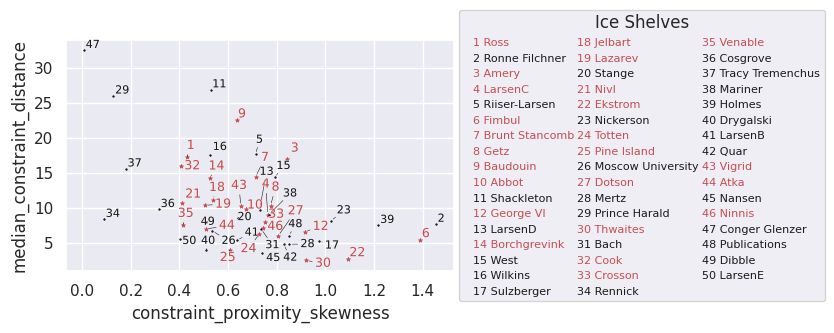

In [35]:
fig, ax = plt.subplots(figsize=(5, 3))

y='median_constraint_distance'
x='constraint_proximity_skewness'

df = ice_shelf_added_constraints

texts_a, texts_b = [], []
for _i, row in df.iterrows():
    row_index = row.name+1
    # plot inverted shelves as red stars and red labels
    if row.NAME in ice_shelf_stats.inverted_shelves:
        ax.scatter(
            x=row[x],
            y=row[y],
            color="r",
            marker="*",
            linewidths=.5,
            s=9,
            label=f"{row_index} {row.NAME.replace('_', ' ')}",
        )
        texts_a.append(
            ax.text(
                row[x],
                row[y],
                f"{row_index}",
                fontsize=9,
                color="r",
                fontweight="normal",
                path_effects=[
                    patheffects.withStroke(linewidth=.5, foreground="white")
                ],
            )
        )
    else:
        ax.scatter(
            x=row[x],
            y=row[y],
            color="k",
            marker=".",
            s=5,
            linewidths=.5,
            label=f"{row_index} {row.NAME.replace('_', ' ')}",
        )
        texts_b.append(
            ax.text(
                row[x],
                row[y],
                f"{row_index}",
                fontsize=8,
                color="k",
                fontweight="normal",
                path_effects=[
                    patheffects.withStroke(
                        linewidth=.5, foreground="white"
                    )
                ],
            )
        )
# auto adjust labels so they dont overlap
adjust_text(
    texts_a + texts_b,
    arrowprops=dict(arrowstyle="-", color="k", lw=0.4),
    ax=ax,
    expand=(1.2, 1.2),
)

ax.set_xlabel(x)
ax.set_ylabel(y)

leg = ax.legend(
    title="Ice Shelves",
    title_fontproperties={'size': 12},
    loc="center left",
    bbox_to_anchor=(1, 0.5),
    handlelength=0,
    columnspacing=-0.5,
    markerscale=0,
    fontsize=8,
    ncol=3,
)
for handle, text in zip(leg.legend_handles, leg.get_texts()):
    text.set_color(handle.get_facecolor()[0])


In [36]:
ice_shelf_added_constraints[ice_shelf_added_constraints.NAME=="Cosgrove"]

,NAME,Regions,TYPE,geometry,area_km,median_constraint_distance,mean_constraint_distance,max_constraint_distance,constraint_proximity_skewness,gravity_disturbance_rms,...,res_stdev,error_rms,error_stdev,residual_constraint_proximity_ratio_rms,residual_constraint_proximity_ratio_stdev,regional_constraint_proximity_ratio_rms,regional_constraint_proximity_ratio_stdev,updated_median_constraint_distance,median_proximity_change,percent_median_proximity_change
35,Cosgrove,West,FL,"POLYGON ((-1756239.555 -353406.569, -1756380.9...",2989.54,9.79091,10.31902,24.00405,0.315979,35.807715,...,9.213472,6.666859,1.636633,206.829329,151.552825,102.278691,96.507563,8.804826,0.986084,10.071424


In [37]:
ice_shelf_added_constraints[ice_shelf_added_constraints.NAME=="Ronne_Filchner"]

,NAME,Regions,TYPE,geometry,area_km,median_constraint_distance,mean_constraint_distance,max_constraint_distance,constraint_proximity_skewness,gravity_disturbance_rms,...,res_stdev,error_rms,error_stdev,residual_constraint_proximity_ratio_rms,residual_constraint_proximity_ratio_stdev,regional_constraint_proximity_ratio_rms,regional_constraint_proximity_ratio_stdev,updated_median_constraint_distance,median_proximity_change,percent_median_proximity_change
1,Ronne_Filchner,West,FL,"POLYGON ((-1006734.891 880592.980, -1006335.92...",427041.7,7.686515,8.739788,46.338298,1.456174,41.514238,...,3.955927,7.952294,1.760702,59.403593,59.405243,350.428117,251.256955,7.680386,0.006128,0.07973


In [6]:
file_path="../results/ice_shelves/"

min_dists = []
min_dist_updates = []
constraints_dfs = []
min_dist_coords = []
shelfs = []
regions = []
names = [
    "Cosgrove",
    "Ronne_Filchner",
    # "Jelbart",
    # "Sulzberger",
    # "Ronne_Filchner",
    # "Conger_Glenzer",
    # "Cook",
    # "Ross
]

for name in names:
    constraints_df = pd.read_csv(f"{file_path}{name}_constraints.csv.gz")

    shelf = ice_shelf_added_constraints[ice_shelf_added_constraints.NAME==name].iloc[0]
    # define region around each ice shelf with 10km buffer
    reg = polar_utils.region_to_bounding_box(shelf.geometry.bounds)
    reg = vd.pad_region(reg, 20e3)

    coords = vd.grid_coordinates(
        region=reg,
        spacing=100,
    )
    grid = vd.make_xarray_grid(coords, np.ones_like(coords[0]), data_names="z").z

    # calculate minimum distance between each grid cell and the nearest point
    min_dist = utils.normalized_mindist(
        constraints_df,
        grid=grid,
    )/1e3
    # mask to the ice shelf outline
    min_dist = polar_utils.mask_from_shp(
        shapefile=shelf,
        xr_grid=min_dist,
        invert=False,
        masked=True,
    )

    df = vd.grid_to_table(min_dist)
    min_dist_coord = df.iloc[df.min_dist.argmax()]

    min_dist_coord = pd.DataFrame([{
        "easting": min_dist_coord.easting,
        "northing": min_dist_coord.northing}])

    # add 1 constraint at point of max proximity
    constraints_df_update = pd.concat(
        [constraints_df, min_dist_coord],
        ignore_index=True,
    )

    # calculate minimum distance between each grid cell and the nearest point
    min_dist_update = utils.normalized_mindist(
        constraints_df_update,
        grid=grid,
    )/1e3

    # mask to the ice shelf outline
    min_dist_update = polar_utils.mask_from_shp(
        shapefile=shelf,
        xr_grid=min_dist_update,
        invert=False,
        masked=True,
    )

    median_before = np.nanmedian(min_dist)
    median_after = np.nanmedian(min_dist_update)
    change = median_after-median_before

    print(f"{name.replace("_", " ")} Ice Shelf",)
    print(f"Median before; {round(median_before,3)} km")
    print(f"Median after; {round(median_after,3)} km")
    print(f"change; {round(change,3)} km")

    constraints_dfs.append(constraints_df)
    shelfs.append(shelf)
    regions.append(reg)
    min_dists.append(min_dist)
    min_dist_updates.append(min_dist_update)
    min_dist_coords.append(min_dist_coord)


Cosgrove Ice Shelf
Median before; 9.791 km
Median after; 8.805 km
change; -0.986 km
Ronne Filchner Ice Shelf
Median before; 7.687 km
Median after; 7.68 km
change; -0.006 km


In [9]:
fig1_width, fig1_height = maps._set_figure_spec(
    region=regions[0],
    fig_height=15,
)[-2:]
print("Figure 1 width/height: ", fig1_width, fig1_height)

fig2_width, fig2_height = maps._set_figure_spec(
    region=regions[1],
    fig_width=fig1_width,
)[-2:]
print("Figure 2 width/height: ", fig2_width, fig2_height)

Figure 1 width/height:  10.748681584442744 15
Figure 2 width/height:  10.748681584442744 9.884388086916847


In [10]:
fig_heights = [fig1_height, fig2_height]

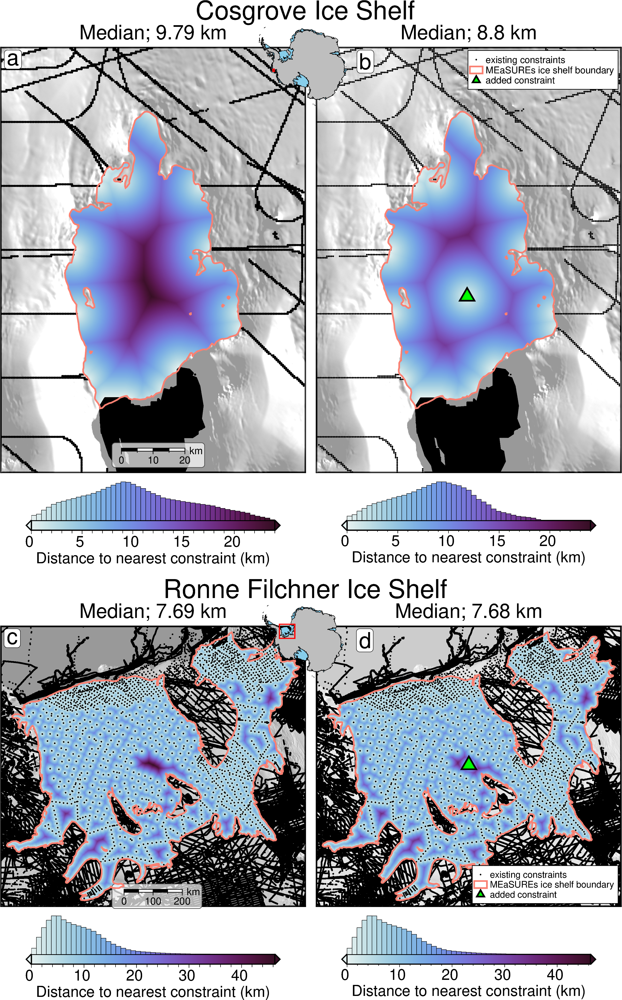

In [14]:
min_dist = min_dists[0]
min_dist_update = min_dist_updates[0]
constraints_df = constraints_dfs[0]
shelf = shelfs[0]
name = names[0]
min_dist_coord = min_dist_coords[0]
fig_height = fig_heights[0]
reg = regions[0]
cpt_lims = (0, polar_utils.get_combined_min_max([min_dist, min_dist_update], robust=False)[1])

fig = maps.plot_grd(
    min_dist,
    fig_height=fig_height,
    region=reg,
    cmap="dense",
    cpt_lims=cpt_lims,
    scalebar=True,
    scalebar_box="+gwhite@30+p0.5p,gray30,solid+r3p",
    modis_basemap=True,
    modis_version="125m",
    modis_transparency=60,
    hist=True,
    points=constraints_df,
    points_style="p2p",
    points_fill="black",
    cbar_label="Distance to nearest constraint (km)",
    cbar_font="20p,Helvetica",
)
fig.text(
    position="TC",
    justify="BC",
    text=f"Median; {round(np.nanmedian(min_dist),2)} km",
    offset=f"0c/.3c",
    font="20p,Helvetica",
    no_clip=True,
)
# plot constraints
fig.plot(
    constraints_df[["easting", "northing"]].iloc[0],
    style="p2p",
    fill="black",
)
# plot outline of ice shelf
fig.plot(
    gpd.GeoDataFrame(geometry=[shelf.geometry]),
    pen="1.5p,salmon",
)

fig.text(
    position="TL",
    text="a",
    fill="white",
    pen=True,
    font="22p,Helvetica,black",
    offset="j.2/.2",
    clearance="+tO",
    no_clip=True,
)
fig.text(
    position="TR",
    justify="BC",
    text=f"{name.replace("_", " ")} Ice Shelf",
    offset=f"0c/1c",
    font="26p,Helvetica",
    no_clip=True,
)


fig = maps.plot_grd(
    min_dist_update,
    fig_height=fig_height,
    fig=fig,
    origin_shift="x",
    region=reg,
    cmap="dense",
    cpt_lims=cpt_lims,
    inset=True,
    inset_width=0.3,
    inset_position="jTL+jTC+o-0.5/-1",
    modis_basemap=True,
    modis_version="125m",
    modis_transparency=60,
    hist=True,
    points=constraints_df,
    points_style="p1.5p",
    points_fill="black",
    cbar_label="Distance to nearest constraint (km)",
    cbar_font="20p,Helvetica",
)
fig.text(
    position="TC",
    justify="BC",
    text=f"Median; {round(np.nanmedian(min_dist_update),2)} km",
    offset=f"0c/.3c",
    font="20p,Helvetica",
    no_clip=True,
)
# plot constraints
fig.plot(
    constraints_df[["easting", "northing"]].iloc[0],
    style="p1.5p",
    fill="black",
    label="existing constraints"
)
# plot outline of ice shelf
fig.plot(
    gpd.GeoDataFrame(geometry=[shelf.geometry]),
    pen="1.5p,salmon",
    label="MEaSUREs ice shelf boundary"
)

# plot additional point
# fake plot for legend
fig.plot(
    min_dist_coord,
    style="t0.3c",
    fill="green",
    pen="1.5p,black",
    label="added constraint",
)
fig.plot(
    min_dist_coord,
    style="t0.6c",
    fill="green",
    pen="1.5p,black",
)
fig.text(
    position="TL",
    text="b",
    fill="white",
    pen=True,
    font="22p,Helvetica,black",
    offset="j1.5/.2",
    clearance="+tO",
    no_clip=True,
)
fig.legend(
    position="JTR+jTR+o0.1c",
    box="+gwhite+p0.5p",
)


###
###
# Plot 2nd shelf
###
###

min_dist = min_dists[1]
min_dist_update = min_dist_updates[1]
constraints_df = constraints_dfs[1]
shelf = shelfs[1]
name = names[1]
min_dist_coord = min_dist_coords[1]
fig_height = fig_heights[1]
reg = regions[1]

cpt_lims = (0, polar_utils.get_combined_min_max([min_dist, min_dist_update], robust=False)[1])

fig = maps.plot_grd(
    min_dist,
    fig_height=fig_height,
    fig=fig,
    origin_shift="both",
    xshift_amount=-1,
    yshift_amount=-1.15,
    region=reg,
    cmap="dense",
    cpt_lims=cpt_lims,
    scalebar=True,
    scalebar_box="+gwhite@30+p0.5p,gray30,solid+r3p",
    modis_basemap=True,
    modis_version="125m",
    modis_transparency=60,
    hist=True,
    points=constraints_df,
    points_style="p1.5p",
    points_fill="black",
    cbar_label="Distance to nearest constraint (km)",
    cbar_font="20p,Helvetica",
)
fig.text(
    position="TC",
    justify="BC",
    text=f"Median; {round(np.nanmedian(min_dist),2)} km",
    offset=f"0c/.3c",
    font="20p,Helvetica",
    no_clip=True,
)
# plot constraints
fig.plot(
    constraints_df[["easting", "northing"]].iloc[0],
    style="p1.5p",
    fill="black",
)
# plot outline of ice shelf
fig.plot(
    gpd.GeoDataFrame(geometry=[shelf.geometry]),
    pen="1.5p,salmon",
)
fig.text(
    position="TL",
    text="c",
    fill="white",
    pen=True,
    font="22p,Helvetica,black",
    offset="j.2/.2",
    clearance="+tO",
    no_clip=True,
)
fig.text(
    position="TR",
    justify="BC",
    text=f"{name.replace("_", " ")} Ice Shelf",
    offset=f"0c/1c",
    font="26p,Helvetica",
    no_clip=True,
)


fig = maps.plot_grd(
    min_dist_update,
    fig_height=fig_height,
    fig=fig,
    origin_shift="x",
    region=reg,
    cmap="dense",
    cpt_lims=cpt_lims,
    inset=True,
    inset_width=0.3,
    inset_position="jTL+jTC+o-0.5/-1",
    modis_basemap=True,
    modis_version="125m",
    modis_transparency=80,
    hist=True,
    points=constraints_df,
    points_style="p1.5p",
    points_fill="black",
    cbar_label="Distance to nearest constraint (km)",
    cbar_font="20p,Helvetica",
)
fig.text(
    position="TC",
    justify="BC",
    text=f"Median; {round(np.nanmedian(min_dist_update),2)} km",
    offset=f"0c/.3c",
    font="20p,Helvetica",
    no_clip=True,
)
# plot constraints
fig.plot(
    constraints_df[["easting", "northing"]].iloc[0],
    style="p1.5p",
    fill="black",
    label="existing constraints"
)
# plot outline of ice shelf
fig.plot(
    gpd.GeoDataFrame(geometry=[shelf.geometry]),
    pen="1.5p,salmon",
    label="MEaSUREs ice shelf boundary"
)

# plot additional point
# fake plot for legend
fig.plot(
    min_dist_coord,
    style="t0.3c",
    fill="green",
    pen="1.5p,black",
    label="added constraint",
)
fig.plot(
    min_dist_coord,
    style="t0.6c",
    fill="green",
    pen="1.5p,black",
)
fig.text(
    position="TL",
    text="d",
    fill="white",
    pen=True,
    font="22p,Helvetica,black",
    offset="j1.5/.2",
    clearance="+tO",
    no_clip=True,
)
fig.legend(
    position="JBR+jBR+o0.1c",
    box="+gwhite+p0.5p",
)

fig.show()

In [15]:
fig.savefig(
    "../paper/figures/constraint_proximity_examples.png",
    dpi=1000,
)

## Estimating optimal gravity line spacing

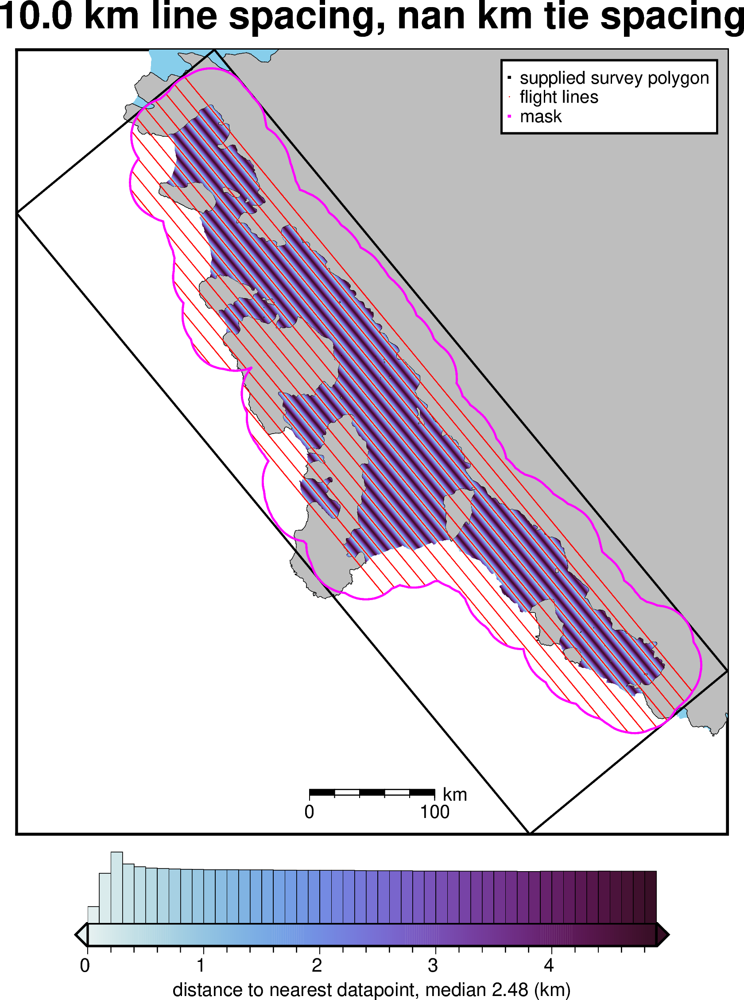

{'number_ties': 0,
 'number_lines': 15,
 'tie_spacing': nan,
 'line_spacing': 10.0,
 'survey_spacing': 10.0,
 'flight_kms': 7318.5,
 'median_proximity': 2.482602248387818,
 'max_proximity': 5.006049348724906,
 'proximity_skew': 0.026583440841156093}

In [345]:
shelf_shp = ice_shelves[ice_shelves.NAME=="Getz"]

shelf_bounds = shelf_shp.minimum_rotated_rectangle().iloc[0]

# calculate length and width of the polygon
x, y = shelf_bounds.exterior.coords.xy
edge_length = (Point(x[0], y[0]).distance(Point(x[1], y[1])), Point(x[1], y[1]).distance(Point(x[2], y[2])))
length = max(edge_length)
width = min(edge_length)
buffer = max(length, width) * 0.05

shelf_bounds = shelf_bounds.buffer(buffer, cap_style="flat", join_style="mitre",)

# create flight lines
grav_survey_df = synthetic.rotated_airborne_survey(
    survey_polygon=shelf_bounds,
    along_line_spacing=500,
    grav_observation_height=1e3,
    line_spacing = 10e3,
    # tie_spacing = 50e3,
    # line_numbers = 4,
    tie_numbers = 0,
    plot=True,
    mask=shelf_shp.buffer(buffer).iloc[0],
    proximity_mask=shelf_shp.iloc[0].geometry,
    survey_spacing_mask=shelf_shp.iloc[0].geometry,
)
grav_survey_df.attrs

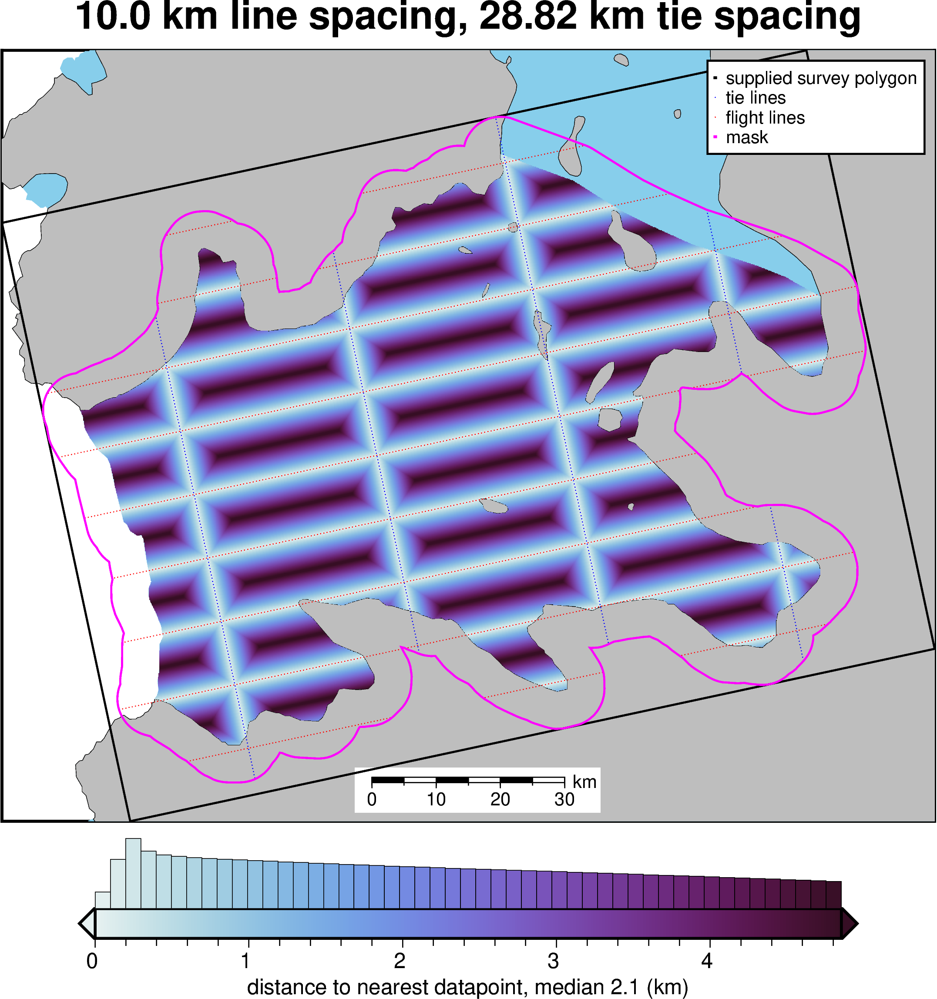

{'number_ties': 4,
 'number_lines': 9,
 'tie_spacing': 28.824355950768414,
 'line_spacing': 10.0,
 'survey_spacing': 19.412177975384207,
 'flight_kms': 1135.5,
 'median_proximity': 2.096438832428336,
 'max_proximity': 5.005509002707998,
 'proximity_skew': 0.24551603151928908}

In [ ]:
shelf_shp = ice_shelves[ice_shelves.NAME=="Dotson"]

shelf_bounds = shelf_shp.minimum_rotated_rectangle().iloc[0]

# calculate length and width of the polygon
x, y = shelf_bounds.exterior.coords.xy
edge_length = (Point(x[0], y[0]).distance(Point(x[1], y[1])), Point(x[1], y[1]).distance(Point(x[2], y[2])))
length = max(edge_length)
width = min(edge_length)
buffer = max(length, width) * 0.05

shelf_bounds = shelf_bounds.buffer(buffer, cap_style="flat", join_style="mitre",)

# create flight lines
grav_survey_df = synthetic.rotated_airborne_survey(
    survey_polygon=shelf_bounds,
    along_line_spacing=500,
    grav_observation_height=1e3,
    line_spacing = 10e3,
    # tie_spacing = 50e3,
    # line_numbers = 4,
    tie_numbers = 4,
    plot=True,
    mask=shelf_shp.buffer(buffer).iloc[0],
    proximity_mask=shelf_shp.iloc[0].geometry,
    survey_spacing_mask=shelf_shp.iloc[0].geometry,
)
grav_survey_df.attrs

(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)


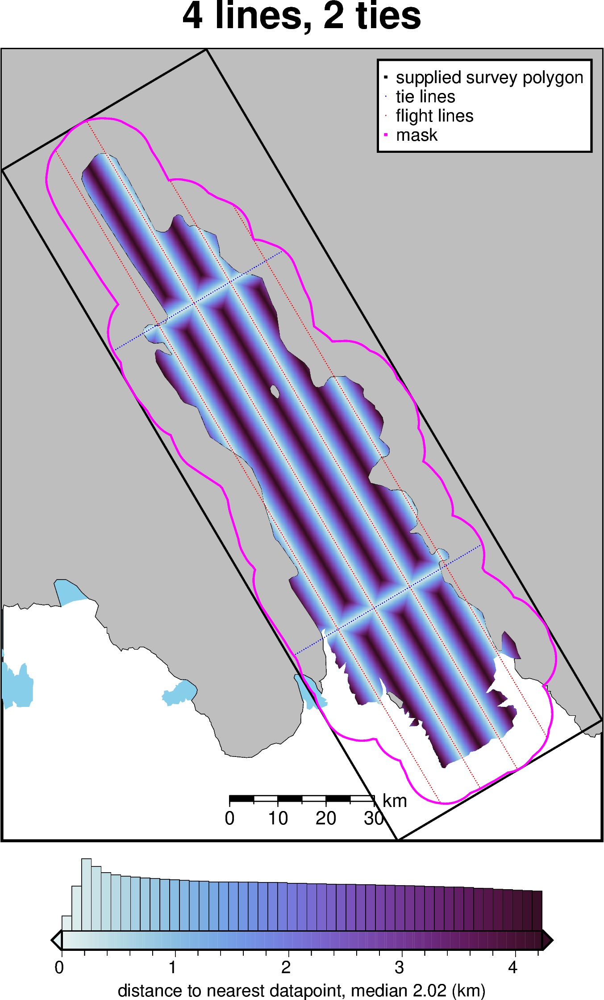

{'number_ties': 2,
 'number_lines': 4,
 'tie_spacing': 73.62872348549706,
 'line_spacing': 8.674035603877469,
 'survey_spacing': 41.151379544687266,
 'flight_kms': 677.0,
 'median_proximity': 2.020216732352776,
 'max_proximity': 4.343599384464118,
 'proximity_skew': 0.11231160153935682}

In [335]:
shelf_shp = ice_shelves[ice_shelves.NAME=="Rennick"]

shelf_bounds = shelf_shp.minimum_rotated_rectangle().iloc[0]

# calculate length and width of the polygon
x, y = shelf_bounds.exterior.coords.xy
edge_length = (Point(x[0], y[0]).distance(Point(x[1], y[1])), Point(x[1], y[1]).distance(Point(x[2], y[2])))
length = max(edge_length)
width = min(edge_length)
buffer = max(length, width) * .05

shelf_bounds = shelf_bounds.buffer(buffer, cap_style="flat", join_style="mitre",)

# create flight lines
grav_survey_df = synthetic.rotated_airborne_survey(
    survey_polygon=shelf_bounds,
    along_line_spacing=500,
    grav_observation_height=1e3,
    # line_spacing = 10e3,
    # tie_spacing = 60e3,
    line_numbers = 4,
    tie_numbers = 2,
    plot=True,
    mask=shelf_shp.buffer(buffer).iloc[0],
    proximity_mask=shelf_shp.iloc[0].geometry,
    survey_spacing_mask=shelf_shp.iloc[0].geometry,
)
grav_survey_df.attrs

In [336]:
num = 30
name = "set_survey_spacing"
name = "set_grav_line_numbers"

# Define number of flights lines on log scale
# values = np.unique(np.round(np.geomspace(1, 30, num)))
values = np.unique(np.round(np.linspace(1, num, num)))
values = [int(i) for i in values]

# Define spacing of lines and ties on log scale
# values = np.geomspace(5e3, 100e3, num)

# turn into dataframe
sampled_params_df = pd.DataFrame(values, columns=[name])

# calculate buffer and shp for ice shelf
shelf_shp = ice_shelves[ice_shelves.NAME=="Rennick"]
shelf_bounds = shelf_shp.minimum_rotated_rectangle().iloc[0]
x, y = shelf_bounds.exterior.coords.xy
edge_length = (Point(x[0], y[0]).distance(Point(x[1], y[1])), Point(x[1], y[1]).distance(Point(x[2], y[2])))
length = max(edge_length)
width = min(edge_length)
buffer = max(length, width) * 0.05
shelf_bounds = shelf_bounds.buffer(buffer, cap_style="flat", join_style="mitre",)

grav_survey_dfs = []
for i, row in sampled_params_df.iterrows():
    val = int(row[name])

    # create flight lines
    grav_survey_df = synthetic.rotated_airborne_survey(
        survey_polygon=shelf_bounds,
        along_line_spacing=500,
        grav_observation_height=1e3,
        line_numbers = val,
        tie_numbers = 3,
        # plot=True,
        mask=shelf_shp.buffer(buffer).iloc[0],
        proximity_mask=shelf_shp.iloc[0].geometry,
        survey_spacing_mask=shelf_shp.iloc[0].geometry,
    )
    grav_survey_dfs.append(grav_survey_df)

    sampled_params_df.loc[i, "grav_lines_numbers"] = len(grav_survey_df.line.unique())
    sampled_params_df.loc[i, "tie_spacing"] = grav_survey_df.attrs.get("tie_spacing")
    sampled_params_df.loc[i, "line_spacing"] = grav_survey_df.attrs.get("line_spacing")
    sampled_params_df.loc[i, "survey_spacing"] = grav_survey_df.attrs.get("survey_spacing")
    sampled_params_df.loc[i, "flight_kms"] = grav_survey_df.attrs.get("flight_kms")
    sampled_params_df.loc[i, "median_proximity"] = grav_survey_df.attrs.get("median_proximity")
    sampled_params_df.loc[i, "max_proximity"] = grav_survey_df.attrs.get("max_proximity")
    sampled_params_df.loc[i, "proximity_skew"] = grav_survey_df.attrs.get("proximity_skew")

sampled_params_df.describe()

(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)


(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -2025257.666672398, -1975835.7795619532)
(578102.2065141718, 740085.3981763546, -

,set_grav_line_numbers,grav_lines_numbers,tie_spacing,line_spacing,survey_spacing,flight_kms,median_proximity,max_proximity,proximity_skew
count,30.000000,30.000000,3.000000e+01,29.000000,30.000000,30.000000,30.000000,30.000000,30.000000
mean,15.500000,18.500000,4.908582e+01,3.583259,27.092913,2402.733333,0.954205,2.336463,0.134958
std,8.803408,8.803408,2.168069e-14,3.608360,4.516287,1291.597172,0.971250,3.336217,0.129332
min,1.000000,4.000000,4.908582e+01,1.156538,25.121177,281.000000,0.321755,0.629424,0.032429
25%,8.250000,11.250000,4.908582e+01,1.508528,25.305743,1340.125000,0.402490,0.802670,0.084575
50%,15.500000,18.500000,4.908582e+01,2.168509,25.663304,2398.250000,0.563351,1.147364,0.108790
75%,22.750000,25.750000,4.908582e+01,3.855127,26.651180,3464.125000,1.009945,2.122246,0.122765
max,30.000000,33.000000,4.908582e+01,17.348071,49.085816,4535.500000,4.670160,17.336884,0.708698


In [337]:
# get best dimensions for subplot
nrows, ncols = polar_utils.square_subplots(len(grav_survey_dfs))

region = polar_utils.region_to_bounding_box(shelf_bounds.bounds)

cols = sampled_params_df.columns
col = cols[cols.str.startswith("set")][0]

row_num = 0
for i, df in enumerate(grav_survey_dfs):
    xshift = 1
    yshift = -1
    scalebar=True
    if i == 0:
        fig = (None,)
        origin_shift = "initialize"
        # scalebar=True
    elif i % ncols == 0:
        origin_shift = "both"
        xshift = (-ncols + 1) * xshift
        row_num += 1
    else:
        origin_shift = "x"

    fig = maps.basemap(
        region=region,
        simple_basemap=True,
        simple_basemap_version="measures-v2",
        title=f"{col[4:]}: {sampled_params_df.loc[i, col]}",
        points=df,
        points_style="p1p",
        fig=fig,
        origin_shift=origin_shift,
        xshift_amount=xshift,
        yshift_amount=yshift,
        scalebar=scalebar,
    )
    fig.plot(
        data=shelf_shp,
        pen="1p,black",
        label="supplied polygon",
    )
fig.show()

In [338]:
sampled_params_df.sort_values("proximity_skew", ascending=False)

,set_grav_line_numbers,grav_lines_numbers,tie_spacing,line_spacing,survey_spacing,flight_kms,median_proximity,max_proximity,proximity_skew
0,1,4.0,49.085816,NaN,49.085816,281.0,4.670160,17.336884,0.708698
1,2,5.0,49.085816,17.348071,33.216943,421.5,3.063294,8.677277,0.446885
2,3,6.0,49.085816,11.565381,30.325598,571.5,2.559434,5.787595,0.168871
3,4,7.0,49.085816,8.674036,28.879926,712.0,1.945432,4.343654,0.162153
4,5,8.0,49.085816,6.939228,28.012522,861.5,1.580371,3.478008,0.152896
5,6,9.0,49.085816,5.782690,27.434253,1011.5,1.343418,2.901865,0.138915
6,7,10.0,49.085816,4.956592,27.021204,1150.0,1.164110,2.489883,0.132191
11,12,15.0,49.085816,2.891345,25.988580,1887.0,0.705539,1.466954,0.123171
13,14,17.0,49.085816,2.478296,25.782056,2186.5,0.612579,1.263187,0.121546
12,13,16.0,49.085816,2.668934,25.877375,2036.5,0.656049,1.357430,0.121392


Text(0, 0.5, 'median_proximity')

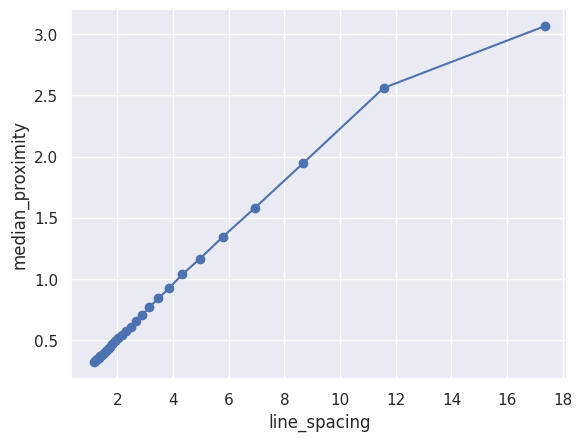

In [343]:
df = sampled_params_df
y="median_proximity"
x="line_spacing"

plt.plot(df[x], df[y], marker="o")
ax = plt.gca()
ax.set_xlabel(x)
ax.set_ylabel(y)

In [ ]:
df = sampled_params_df
y="median_proximity"
x="flight_kms"

plt.plot(df[x], df[y], marker="o")
ax = plt.gca()
ax.set_xlabel(x)
ax.set_ylabel(y)

Text(0, 0.5, 'median_proximity')

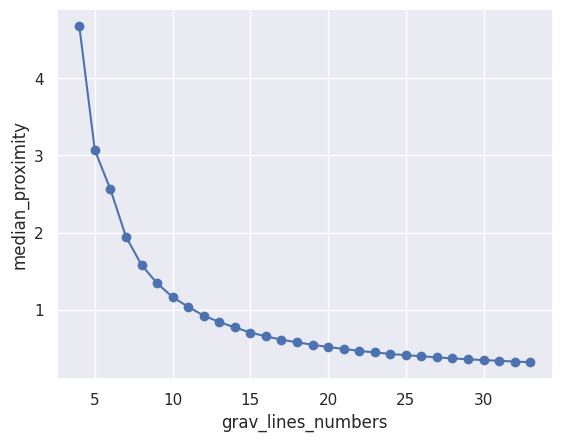

In [342]:
df = sampled_params_df
y="median_proximity"
x="grav_lines_numbers"

plt.plot(df[x], df[y], marker="o")
ax = plt.gca()
ax.set_xlabel(x)
ax.set_ylabel(y)

Max y value at x value: 281.0
Max y value: 0.7086984965024377


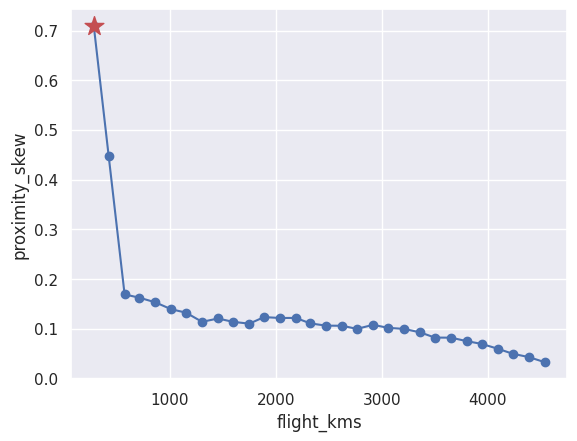

In [ ]:
df = sampled_params_df
y="proximity_skew"
x="flight_kms"

plt.plot(df[x], df[y], marker="o")
ax = plt.gca()
ax.set_xlabel(x)
ax.set_ylabel(y)

max_ind = df[y].idxmax()
ax.scatter(
    x=df[x].iloc[max_ind],
    y=df[y].iloc[max_ind],
    marker="*",
    c='r',
    s=200,
    zorder=20,
)
print(f"Max y value at x value: {df[x].iloc[max_ind]}")
print(f"Max y value: {df[y].iloc[max_ind]}")

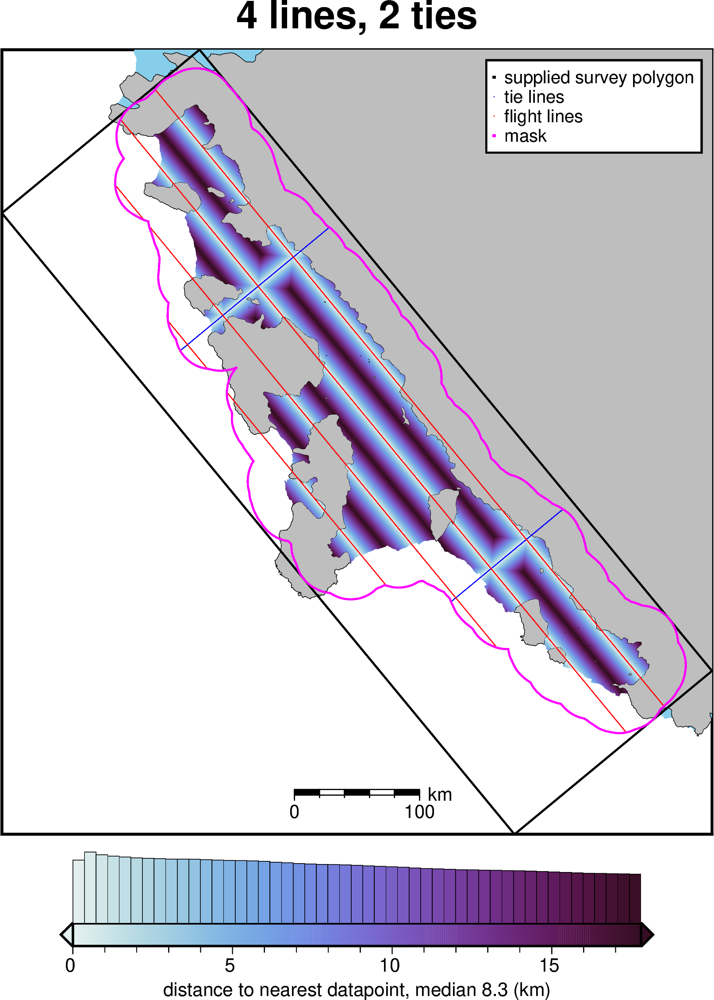

{'number_ties': 2,
 'number_lines': 4,
 'tie_spacing': 291.355052479669,
 'line_spacing': 36.46132702376717,
 'survey_spacing': 163.90818975171808,
 'flight_kms': 2258.5,
 'median_proximity': 8.302668529964075,
 'max_proximity': 18.232133066089165,
 'proximity_skew': 0.12649384819760462}

In [22]:
shelf_shp = ice_shelves[ice_shelves.NAME=="Getz"]

shelf_bounds = shelf_shp.minimum_rotated_rectangle().iloc[0]

# calculate length and width of the polygon
x, y = shelf_bounds.exterior.coords.xy
edge_length = (Point(x[0], y[0]).distance(Point(x[1], y[1])), Point(x[1], y[1]).distance(Point(x[2], y[2])))
length = max(edge_length)
width = min(edge_length)
buffer = max(length, width) * .05

shelf_bounds = shelf_bounds.buffer(buffer, cap_style="flat", join_style="mitre",)

# create flight lines
grav_survey_df = synthetic.rotated_airborne_survey(
    survey_polygon=shelf_bounds,
    along_line_spacing=500,
    grav_observation_height=1e3,
    # line_spacing = 10e3,
    # tie_spacing = 60e3,
    line_numbers = 4,
    tie_numbers = 2,
    plot=True,
    mask=shelf_shp.buffer(buffer).iloc[0],
    proximity_mask=shelf_shp.iloc[0].geometry,
    survey_spacing_mask=shelf_shp.iloc[0].geometry,
)
grav_survey_df.attrs

In [40]:
num = 30
name = "set_survey_spacing"
name = "set_grav_line_numbers"

# Define number of flights lines on log scale
# values = np.unique(np.round(np.geomspace(1, 30, num)))
values = np.unique(np.round(np.linspace(1, num, num)))
values = [int(i) for i in values]

# Define spacing of lines and ties on log scale
# values = np.geomspace(5e3, 100e3, num)

# turn into dataframe
sampled_params_df = pd.DataFrame(values, columns=[name])

# calculate buffer and shp for ice shelf
shelf_shp = ice_shelves[ice_shelves.NAME=="Getz"]
shelf_bounds = shelf_shp.minimum_rotated_rectangle().iloc[0]
x, y = shelf_bounds.exterior.coords.xy
edge_length = (Point(x[0], y[0]).distance(Point(x[1], y[1])), Point(x[1], y[1]).distance(Point(x[2], y[2])))
length = max(edge_length)
width = min(edge_length)
buffer = max(length, width) * 0.05
shelf_bounds = shelf_bounds.buffer(buffer, cap_style="flat", join_style="mitre",)

grav_survey_dfs = []
for i, row in sampled_params_df.iterrows():
    val = int(row[name])

    # create flight lines
    grav_survey_df = synthetic.rotated_airborne_survey(
        survey_polygon=shelf_bounds,
        along_line_spacing=500,
        grav_observation_height=1e3,
        line_numbers = val,
        tie_numbers = 0,
        # plot=True,
        mask=shelf_shp.buffer(buffer).iloc[0],
        proximity_mask=shelf_shp.iloc[0].geometry,
        survey_spacing_mask=shelf_shp.iloc[0].geometry,
    )
    grav_survey_dfs.append(grav_survey_df)

    sampled_params_df.loc[i, "grav_lines_numbers"] = len(grav_survey_df.line.unique())
    sampled_params_df.loc[i, "tie_spacing"] = grav_survey_df.attrs.get("tie_spacing")
    sampled_params_df.loc[i, "line_spacing"] = grav_survey_df.attrs.get("line_spacing")
    sampled_params_df.loc[i, "survey_spacing"] = grav_survey_df.attrs.get("survey_spacing")
    sampled_params_df.loc[i, "flight_kms"] = grav_survey_df.attrs.get("flight_kms")
    sampled_params_df.loc[i, "median_proximity"] = grav_survey_df.attrs.get("median_proximity")
    sampled_params_df.loc[i, "max_proximity"] = grav_survey_df.attrs.get("max_proximity")
    sampled_params_df.loc[i, "proximity_skew"] = grav_survey_df.attrs.get("proximity_skew")

sampled_params_df.describe()

,set_grav_line_numbers,grav_lines_numbers,tie_spacing,line_spacing,survey_spacing,flight_kms,median_proximity,max_proximity,proximity_skew
count,30.000000,30.000000,0.0,29.000000,29.000000,30.000000,30.000000,30.000000,30.000000
mean,15.500000,15.500000,NaN,15.062235,15.062235,7605.033333,4.506766,9.716518,0.036440
std,8.803408,8.803408,NaN,15.167751,15.167751,4313.041066,6.009317,14.067322,0.066771
min,1.000000,1.000000,NaN,4.861510,4.861510,578.500000,1.221332,2.443451,-0.014990
25%,8.250000,8.250000,NaN,6.341100,6.341100,4014.750000,1.611471,3.216271,0.015984
50%,15.500000,15.500000,NaN,9.115332,9.115332,7615.500000,2.355271,4.716116,0.026153
75%,22.750000,22.750000,NaN,16.205034,16.205034,11148.750000,4.414382,8.865561,0.033332
max,30.000000,30.000000,NaN,72.922654,72.922654,14717.500000,31.881381,72.898027,0.366372


In [ ]:
# get best dimensions for subplot
nrows, ncols = polar_utils.square_subplots(len(grav_survey_dfs))

region = polar_utils.region_to_bounding_box(shelf_bounds.bounds)

cols = sampled_params_df.columns
col = cols[cols.str.startswith("set")][0]

row_num = 0
for i, df in enumerate(grav_survey_dfs):
    xshift = 1
    yshift = -1
    scalebar=True
    if i == 0:
        fig = (None,)
        origin_shift = "initialize"
        # scalebar=True
    elif i % ncols == 0:
        origin_shift = "both"
        xshift = (-ncols + 1) * xshift
        row_num += 1
    else:
        origin_shift = "x"

    fig = maps.basemap(
        region=region,
        simple_basemap=True,
        simple_basemap_version="measures-v2",
        title=f"{col[4:]}: {sampled_params_df.loc[i, col]}",
        points=df,
        points_style="p1p",
        fig=fig,
        origin_shift=origin_shift,
        xshift_amount=xshift,
        yshift_amount=yshift,
        scalebar=scalebar,
    )
    fig.plot(
        data=shelf_shp,
        pen="1p,black",
        label="supplied polygon",
    )
fig.show()

In [42]:
sampled_params_df.sort_values("proximity_skew", ascending=False)

,set_grav_line_numbers,grav_lines_numbers,tie_spacing,line_spacing,survey_spacing,flight_kms,median_proximity,max_proximity,proximity_skew
1,2,2.0,NaN,72.922654,72.922654,961.0,13.763512,36.462009,0.366372
2,3,3.0,NaN,48.615103,48.615103,1491.0,11.271300,24.308773,0.108153
4,5,5.0,NaN,29.169062,29.169062,2415.5,6.904897,14.586501,0.077643
3,4,4.0,NaN,36.461327,36.461327,1989.0,8.852953,18.232133,0.043198
29,30,30.0,NaN,4.861510,4.861510,14717.5,1.221332,2.443451,0.038568
27,28,28.0,NaN,5.208761,5.208761,13736.5,1.306231,2.616282,0.037081
28,29,29.0,NaN,5.029149,5.029149,14222.5,1.265001,2.526803,0.034645
26,27,27.0,NaN,5.401678,5.401678,13243.5,1.355625,2.712255,0.033937
25,26,26.0,NaN,5.609435,5.609435,12746.0,1.408164,2.815537,0.031517
5,6,6.0,NaN,24.307551,24.307551,2972.5,5.956637,12.156274,0.031371


Text(0, 0.5, 'median_proximity')

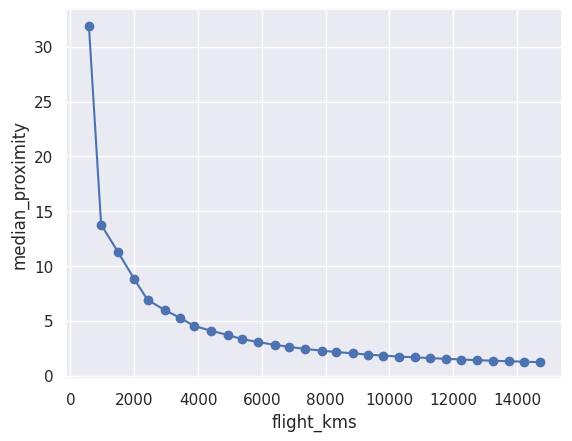

In [43]:
df = sampled_params_df
y="median_proximity"
x="flight_kms"

plt.plot(df[x], df[y], marker="o")
ax = plt.gca()
ax.set_xlabel(x)
ax.set_ylabel(y)

Text(0, 0.5, 'median_proximity')

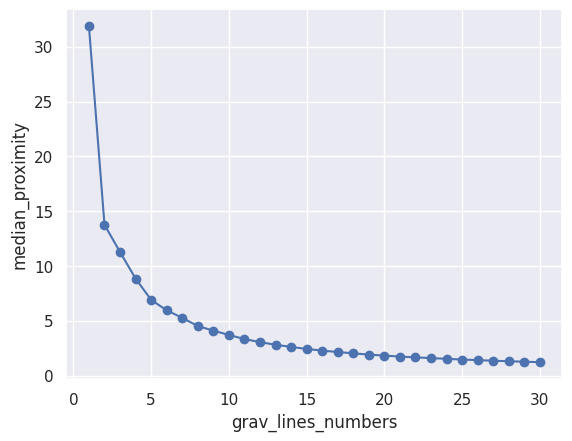

In [44]:
df = sampled_params_df
y="median_proximity"
x="grav_lines_numbers"

plt.plot(df[x], df[y], marker="o")
ax = plt.gca()
ax.set_xlabel(x)
ax.set_ylabel(y)

Text(0, 0.5, 'line_spacing')

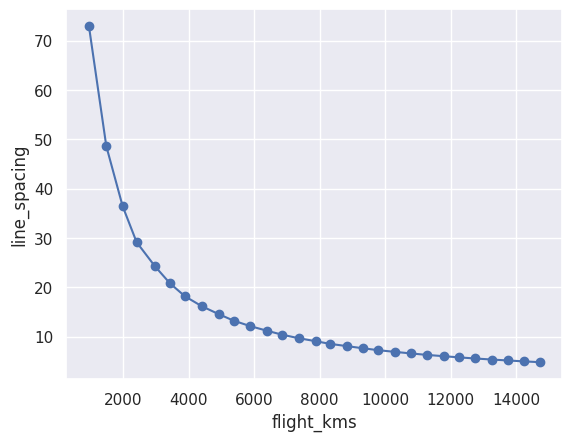

In [45]:
df = sampled_params_df
y="line_spacing"
x="flight_kms"

plt.plot(df[x], df[y], marker="o")
ax = plt.gca()
ax.set_xlabel(x)
ax.set_ylabel(y)

Text(0, 0.5, 'proximity_skew')

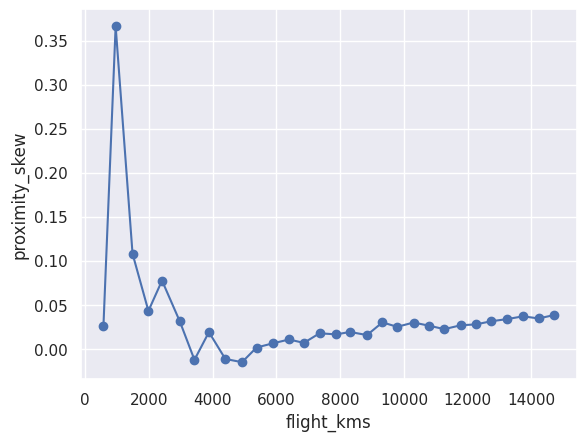

In [46]:
df = sampled_params_df
y="proximity_skew"
x="flight_kms"

plt.plot(df[x], df[y], marker="o")
ax = plt.gca()
ax.set_xlabel(x)
ax.set_ylabel(y)

Text(0, 0.5, 'proximity_skew')

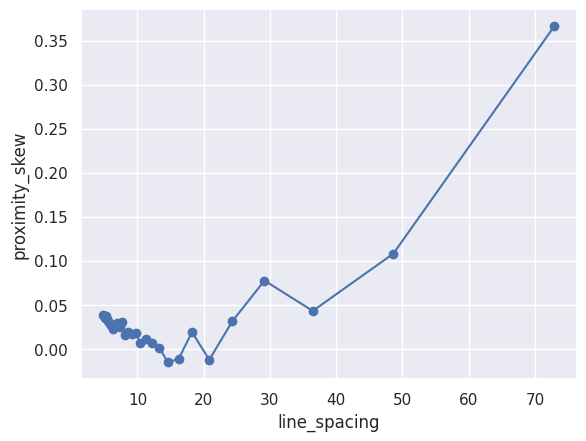

In [47]:
df = sampled_params_df
y="proximity_skew"
x="line_spacing"

plt.plot(df[x], df[y], marker="o")
ax = plt.gca()
ax.set_xlabel(x)
ax.set_ylabel(y)

Text(0, 0.5, 'proximity_skew')

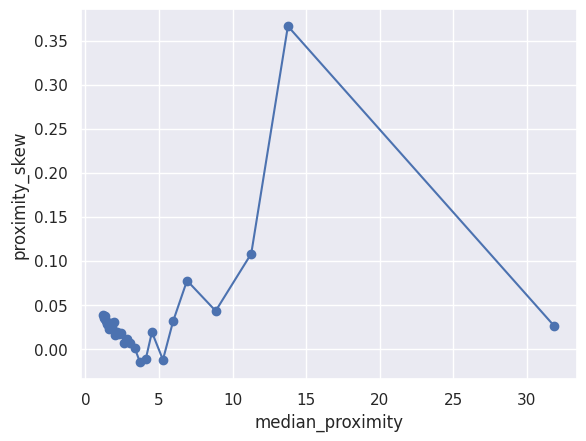

In [48]:
df = sampled_params_df
y="proximity_skew"
x="median_proximity"

plt.plot(df[x], df[y], marker="o")
ax = plt.gca()
ax.set_xlabel(x)
ax.set_ylabel(y)

In [ ]:
df = sampled_params_df
y="proximity_skew"
x="median_proximity"

plt.plot(df[x], df[y], marker="o")
ax = plt.gca()
ax.set_xlabel(x)
ax.set_ylabel(y)

### Getz Ice Shelf analysis

In [24]:
import pooch
import requests
import pathlib

def fetch_getz_gravity():
    """
    Fetch the available gravity for the Getz Ice Shelf. This include a helicopter
    gravity dataset from Wei et al. 2020 and several Operation Ice Bridge (OIB) flights.

    Heli grav accessed from https://zenodo.org/records/3695943

    """
    ###
    ###
    # Heli grav
    ###
    ###
    url = "https://zenodo.org/records/3695943/files/helo_grv.xyz?download=1"
    path = pooch.retrieve(
        url=url,
        fname="wei_et_al_2020_helicopter_gravity.xyz",
        path=f"{pooch.os_cache('pooch')}/goat",
        known_hash="md5:ea615136c14c0b4a2254317043ca65ec",
        progressbar=True,
        # processor=preprocessing,
    )

    heli_df = pd.read_csv(
        path,
        header=None,
        sep=r"\s+",
        names=["easting", "northing", "gravity"],
    )

    ###
    ###
    # OIB grav
    ###
    ###
    count=0

    if pathlib.Path(f"{pooch.os_cache('pooch')}/goat/gravity/oib_getz.csv").exists():
        df = pd.read_csv(
            f"{pooch.os_cache('pooch')}/goat/gravity/oib_getz.csv",
            # index=False,
        )
    else:
        urls = [t for t in oib_url_list if t.endswith("txt")]

        dfs = []
        for url in tqdm(urls, total=len(urls), desc="txt files"):
            try:
                fname = pooch.retrieve(
                    url=url,
                    path=f"{pooch.os_cache('pooch')}/goat/gravity",
                    # fname="bedmap2_point_data.zip",
                    known_hash=None,
                    progressbar=True,
                    # processor=preprocessing,
                    downloader=fetch.EarthDataDownloader(),
                )
            except requests.exceptions.HTTPError as e:
                logger.error(e)
                logger.error(f"Failed to download {url}")
                count+=1
                continue
            df = pd.read_csv(
                fname,
                comment="#",
                header=None,
                usecols=[5,6,7,8,14,15,16,17],
                names=[
                    'line',
                    'x',
                    'y',
                    'height',
                    "levelling_correction",
                    'free_air_gravity_70s',
                    'free_air_gravity_100s',
                    'free_air_gravity_140s',
                ],
                sep=r"\s+",
            )
            df = df.dropna()
            df = utils.points_inside_region(df, getz_region)
            dfs.append(df)

        df = pd.concat(dfs)
        df.to_csv(f"{pooch.os_cache('pooch')}/goat/gravity/oib_getz.csv", index=False)

    if count>0:
        logger.warning(f"Failed to download {count} files")

    oib_df = df.rename(columns={"x": "easting", "y": "northing"})

    oib_df = oib_df[oib_df.height < 2000]

    ###
    ###
    # merge helicoper and oib gravity data
    ###
    ###

    oib_df["source"] = "oib"
    oib_df["gravity"]= oib_df.free_air_gravity_70s
    heli_df["source"] = "heli"
    heli_df["height"] = 500 # made this up!!!

    # reorder columns
    oib_df = oib_df[ ['easting','northing'] + [ col for col in oib_df.columns if col not in ['easting','northing'] ] ]
    heli_df = heli_df[ ['easting','northing'] + [ col for col in heli_df.columns if col not in ['easting','northing'] ] ]

    return pd.concat(
        [
            oib_df,
            heli_df,
        ],
        axis=0,
        ignore_index=True,
    )

oib_url_list = ['https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2010.10.30/IGGRV1B_20101030_11190700_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2010.10.30/IGGRV1B_20101030_11190700_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2010.11.05/IGGRV1B_20101105_11512800_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2010.11.05/IGGRV1B_20101105_11512800_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.10.31/IGGRV1B_20161031_12281500_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.10.31/IGGRV1B_20161031_12281500_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2012.10.13/IGGRV1B_20121013_12580800_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2012.10.13/IGGRV1B_20121013_12580800_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2018.11.15/IGGRV1B_20181115_11523800_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2018.11.15/IGGRV1B_20181115_11523800_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2014.11.02/IGGRV1B_20141102_10162900_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2014.11.02/IGGRV1B_20141102_10162900_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2012.10.27/IGGRV1B_20121027_11230800_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2012.10.27/IGGRV1B_20121027_11230800_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2011.11.11/IGGRV1B_20111111_11433200_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2011.11.11/IGGRV1B_20111111_11433200_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.11.03/IGGRV1B_20161103_12092900_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.11.03/IGGRV1B_20161103_12092900_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.11.05/IGGRV1B_20161105_12014000_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.11.05/IGGRV1B_20161105_12014000_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2009.10.16/IGGRV1B_20091016_11013000_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2009.10.16/IGGRV1B_20091016_11013000_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2011.11.09/IGGRV1B_20111109_10554400_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2011.11.09/IGGRV1B_20111109_10554400_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.11.09/IGGRV1B_20161109_11444900_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.11.09/IGGRV1B_20161109_11444900_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.11.02/IGGRV1B_20161102_12211900_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.11.02/IGGRV1B_20161102_12211900_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.11.07/IGGRV1B_20161107_11532100_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.11.07/IGGRV1B_20161107_11532100_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2012.10.23/IGGRV1B_20121023_13062800_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2012.10.23/IGGRV1B_20121023_13062800_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2014.11.21/IGGRV1B_20141121_10163100_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2014.11.21/IGGRV1B_20141121_10163100_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2009.10.28/IGGRV1B_20091028_11240400_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2009.10.28/IGGRV1B_20091028_11240400_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2018.11.11/IGGRV1B_20181111_12085800_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2018.11.11/IGGRV1B_20181111_12085800_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.10.20/IGGRV1B_20161020_12355800_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.10.20/IGGRV1B_20161020_12355800_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2009.11.12/IGGRV1B_20091112_12344500_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2009.11.12/IGGRV1B_20091112_12344500_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2014.11.03/IGGRV1B_20141103_10253900_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2014.11.03/IGGRV1B_20141103_10253900_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2011.10.17/IGGRV1B_20111017_10331900_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2011.10.17/IGGRV1B_20111017_10331900_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2011.11.04/IGGRV1B_20111104_13313800_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2011.11.04/IGGRV1B_20111104_13313800_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2011.11.13/IGGRV1B_20111113_11351100_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2011.11.13/IGGRV1B_20111113_11351100_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.11.15/IGGRV1B_20161115_11195400_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.11.15/IGGRV1B_20161115_11195400_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2014.11.07/IGGRV1B_20141107_10125100_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2014.11.07/IGGRV1B_20141107_10125100_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.10.28/IGGRV1B_20161028_12182900_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2016.10.28/IGGRV1B_20161028_12182900_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2011.11.03/IGGRV1B_20111103_11000800_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2011.11.03/IGGRV1B_20111103_11000800_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2012.10.12/IGGRV1B_20121012_11344800_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2012.10.12/IGGRV1B_20121012_11344800_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2018.10.31/IGGRV1B_20181031_13465700_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2018.10.31/IGGRV1B_20181031_13465700_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2018.11.03/IGGRV1B_20181103_11233800_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2018.11.03/IGGRV1B_20181103_11233800_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2013.11.25/IGGRV1B_20131125_17123900_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2013.11.25/IGGRV1B_20131125_17123900_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2014.11.13/IGGRV1B_20141113_10431700_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2014.11.13/IGGRV1B_20141113_10431700_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2010.11.06/IGGRV1B_20101106_11465700_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2010.11.06/IGGRV1B_20101106_11465700_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2009.11.18/IGGRV1B_20091118_11060500_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2009.11.18/IGGRV1B_20091118_11060500_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2010.11.19/IGGRV1B_20101119_16531400_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2010.11.19/IGGRV1B_20101119_16531400_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2011.10.23/IGGRV1B_20111023_10540400_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2011.10.23/IGGRV1B_20111023_10540400_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2011.11.12/IGGRV1B_20111112_12105300_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2011.11.12/IGGRV1B_20111112_12105300_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2009.10.21/IGGRV1B_20091021_12014500_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2009.10.21/IGGRV1B_20091021_12014500_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2009.11.02/IGGRV1B_20091102_11082400_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2009.11.02/IGGRV1B_20091102_11082400_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2009.10.18/IGGRV1B_20091018_11011500_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2009.10.18/IGGRV1B_20091018_11011500_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2014.11.11/IGGRV1B_20141111_10150500_V019.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.001/2014.11.11/IGGRV1B_20141111_10150500_V019.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2009.10.16/IGGRV1B_20091016_11515650_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2009.10.16/IGGRV1B_20091016_11515650_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2009.10.16/IGGRV1B_20091016_11515650_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2009.10.18/IGGRV1B_20091018_11442050_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2009.10.18/IGGRV1B_20091018_11442050_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2009.10.18/IGGRV1B_20091018_11442050_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2009.10.21/IGGRV1B_20091021_12433200_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2009.10.21/IGGRV1B_20091021_12433200_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2009.10.21/IGGRV1B_20091021_12433200_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2009.10.28/IGGRV1B_20091028_11592500_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2009.10.28/IGGRV1B_20091028_11592500_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2009.10.28/IGGRV1B_20091028_11592500_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2009.11.02/IGGRV1B_20091102_13064950_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2009.11.02/IGGRV1B_20091102_13064950_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2009.11.02/IGGRV1B_20091102_13064950_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2009.11.12/IGGRV1B_20091112_13580700_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2009.11.12/IGGRV1B_20091112_13580700_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2009.11.12/IGGRV1B_20091112_13580700_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2009.11.18/IGGRV1B_20091118_11492450_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2009.11.18/IGGRV1B_20091118_11492450_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2009.11.18/IGGRV1B_20091118_11492450_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2010.10.30/IGGRV1B_20101030_11531750_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2010.10.30/IGGRV1B_20101030_11531750_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2010.10.30/IGGRV1B_20101030_11531750_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2010.11.05/IGGRV1B_20101105_12532350_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2010.11.05/IGGRV1B_20101105_12532350_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2010.11.05/IGGRV1B_20101105_12532350_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2010.11.06/IGGRV1B_20101106_12554650_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2010.11.06/IGGRV1B_20101106_12554650_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2010.11.06/IGGRV1B_20101106_12554650_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2010.11.19/IGGRV1B_20101119_17290550_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2010.11.19/IGGRV1B_20101119_17290550_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2010.11.19/IGGRV1B_20101119_17290550_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2011.10.17/IGGRV1B_20111017_11494300_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2011.10.17/IGGRV1B_20111017_11494300_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2011.10.17/IGGRV1B_20111017_11494300_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2011.10.23/IGGRV1B_20111023_11491000_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2011.10.23/IGGRV1B_20111023_11491000_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2011.10.23/IGGRV1B_20111023_11491000_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.03/IGGRV1B_20111103_11464750_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.03/IGGRV1B_20111103_11464750_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.03/IGGRV1B_20111103_11464750_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.04/IGGRV1B_20111104_14314700_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.04/IGGRV1B_20111104_14314700_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.04/IGGRV1B_20111104_14314700_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.09/IGGRV1B_20111109_12031600_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.09/IGGRV1B_20111109_12031600_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.09/IGGRV1B_20111109_12031600_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.11/IGGRV1B_20111111_13592250_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.11/IGGRV1B_20111111_13592250_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.11/IGGRV1B_20111111_13592250_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.12/IGGRV1B_20111112_13481200_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.12/IGGRV1B_20111112_13481200_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.12/IGGRV1B_20111112_13481200_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.13/IGGRV1B_20111113_12430500_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.13/IGGRV1B_20111113_12430500_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2011.11.13/IGGRV1B_20111113_12430500_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2012.10.12/IGGRV1B_20121012_11550450_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2012.10.12/IGGRV1B_20121012_11550450_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2012.10.12/IGGRV1B_20121012_11550450_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2012.10.13/IGGRV1B_20121013_13172000_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2012.10.13/IGGRV1B_20121013_13172000_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2012.10.13/IGGRV1B_20121013_13172000_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2012.10.23/IGGRV1B_20121023_13262900_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2012.10.23/IGGRV1B_20121023_13262900_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2012.10.23/IGGRV1B_20121023_13262900_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2012.10.27/IGGRV1B_20121027_11433100_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2012.10.27/IGGRV1B_20121027_11433100_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2012.10.27/IGGRV1B_20121027_11433100_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2013.11.25/IGGRV1B_20131125_18560050_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2013.11.25/IGGRV1B_20131125_18560050_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2013.11.25/IGGRV1B_20131125_18560050_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.02/IGGRV1B_20141102_11423800_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.02/IGGRV1B_20141102_11423800_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.02/IGGRV1B_20141102_11423800_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.03/IGGRV1B_20141103_11431000_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.03/IGGRV1B_20141103_11431000_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.03/IGGRV1B_20141103_11431000_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.07/IGGRV1B_20141107_11393500_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.07/IGGRV1B_20141107_11393500_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.07/IGGRV1B_20141107_11393500_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.11/IGGRV1B_20141111_11455100_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.11/IGGRV1B_20141111_11455100_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.11/IGGRV1B_20141111_11455100_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.13/IGGRV1B_20141113_11463900_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.13/IGGRV1B_20141113_11463900_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.13/IGGRV1B_20141113_11463900_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.21/IGGRV1B_20141121_11454150_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.21/IGGRV1B_20141121_11454150_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2014.11.21/IGGRV1B_20141121_11454150_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.10.20/IGGRV1B_20161020_12504700_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2016.10.20/IGGRV1B_20161020_12504700_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.10.20/IGGRV1B_20161020_12504700_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.10.26/IGGRV1B_20161026_12495550_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2016.10.26/IGGRV1B_20161026_12495550_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.10.26/IGGRV1B_20161026_12495550_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.10.28/IGGRV1B_20161028_12535500_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2016.10.28/IGGRV1B_20161028_12535500_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.10.28/IGGRV1B_20161028_12535500_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.10.31/IGGRV1B_20161031_13030750_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2016.10.31/IGGRV1B_20161031_13030750_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.10.31/IGGRV1B_20161031_13030750_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.02/IGGRV1B_20161102_12471700_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.02/IGGRV1B_20161102_12471700_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.02/IGGRV1B_20161102_12471700_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.03/IGGRV1B_20161103_13115450_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.03/IGGRV1B_20161103_13115450_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.03/IGGRV1B_20161103_13115450_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.05/IGGRV1B_20161105_12472350_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.05/IGGRV1B_20161105_12472350_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.05/IGGRV1B_20161105_12472350_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.07/IGGRV1B_20161107_12445850_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.07/IGGRV1B_20161107_12445850_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.07/IGGRV1B_20161107_12445850_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.09/IGGRV1B_20161109_12445200_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.09/IGGRV1B_20161109_12445200_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.09/IGGRV1B_20161109_12445200_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.15/IGGRV1B_20161115_12473400_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.15/IGGRV1B_20161115_12473400_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2016.11.15/IGGRV1B_20161115_12473400_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2018.10.31/IGGRV1B_20181031_14545400_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2018.10.31/IGGRV1B_20181031_14545400_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2018.10.31/IGGRV1B_20181031_14545400_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2018.11.11/IGGRV1B_20181111_12491100_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2018.11.11/IGGRV1B_20181111_12491100_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2018.11.11/IGGRV1B_20181111_12491100_V020.txt.xml',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2018.11.15/IGGRV1B_20181115_12395800_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/opendap/DP4/ICEBRIDGE/IGGRV1B.002/2018.11.15/IGGRV1B_20181115_12395800_V020.txt',
 'https://n5eil01u.ecs.nsidc.org/DP4/ICEBRIDGE/IGGRV1B.002/2018.11.15/IGGRV1B_20181115_12395800_V020.txt.xml',
 ]


In [19]:
getz_shp = ice_shelves[ice_shelves.NAME=="Getz"]
getz_shp

,NAME,Regions,TYPE,geometry,area_km
7,Getz,West,FL,"MULTIPOLYGON (((-1464395.442 -1011065.611, -14...",33389.04


In [43]:
region = (-1595257.0454419143, -1159500.0, -1204272.2147671788, -694000.0)

In [25]:
getz_grav_df = fetch_getz_gravity()
getz_grav_df

,easting,northing,line,height,levelling_correction,free_air_gravity_70s,free_air_gravity_100s,free_air_gravity_140s,source,gravity
0,-1603055.66,-686143.62,106.0,668.89,-0.04,-7.78,-7.17,-8.09,oib,-7.78000
1,-1603021.20,-686211.93,106.0,666.51,-0.04,-7.72,-7.09,-8.01,oib,-7.72000
2,-1602986.81,-686280.21,106.0,664.12,-0.04,-7.66,-7.01,-7.92,oib,-7.66000
3,-1602952.50,-686348.45,106.0,661.72,-0.04,-7.60,-6.93,-7.83,oib,-7.60000
4,-1602918.26,-686416.66,106.0,659.35,-0.04,-7.54,-6.85,-7.74,oib,-7.54000
...,...,...,...,...,...,...,...,...,...,...
624896,-1420237.00,-930435.70,NaN,500.00,NaN,NaN,NaN,NaN,heli,-47.59918
624897,-1420104.00,-930435.70,NaN,500.00,NaN,NaN,NaN,NaN,heli,-47.55980
624898,-1419970.00,-930435.70,NaN,500.00,NaN,NaN,NaN,NaN,heli,-47.52267
624899,-1419837.00,-930435.70,NaN,500.00,NaN,NaN,NaN,NaN,heli,-47.48719


In [44]:
coords = vd.grid_coordinates(
    region=region,
    spacing=100,
)
grid = vd.make_xarray_grid(coords, np.ones_like(coords[0]), data_names="z").z

min_dist = utils.normalized_mindist(
    getz_grav_df,
    grid=grid,
)/1e3


# get median value inside ice shelf
getz_grav_min_dist = polar_utils.mask_from_shp(
    shapefile=getz_shp,
    xr_grid=min_dist,
    masked=True,
    invert=False,
)
print(f"Median gravity proximity: {round(np.nanmedian(getz_grav_min_dist),3)} km")

Median gravity proximity: 1.807 km


In [45]:
constraints_df = pd.read_csv(f"{file_path}/Getz_constraints.csv.gz")

coords = vd.grid_coordinates(
    region=region,
    spacing=100,
)
grid = vd.make_xarray_grid(coords, np.ones_like(coords[0]), data_names="z").z

# calculate minimum distance between each grid cell and the nearest point
min_dist = utils.normalized_mindist(
    constraints_df,
    grid=grid,
)/1e3
# mask to the ice shelf outline
getz_constraints_min_dist = polar_utils.mask_from_shp(
    shapefile=getz_shp,
    xr_grid=min_dist,
    invert=False,
    masked=True,
)
print(f"Median constraints proximity: {round(np.nanmedian(getz_constraints_min_dist),3)} km")

Median constraints proximity: 10.336 km


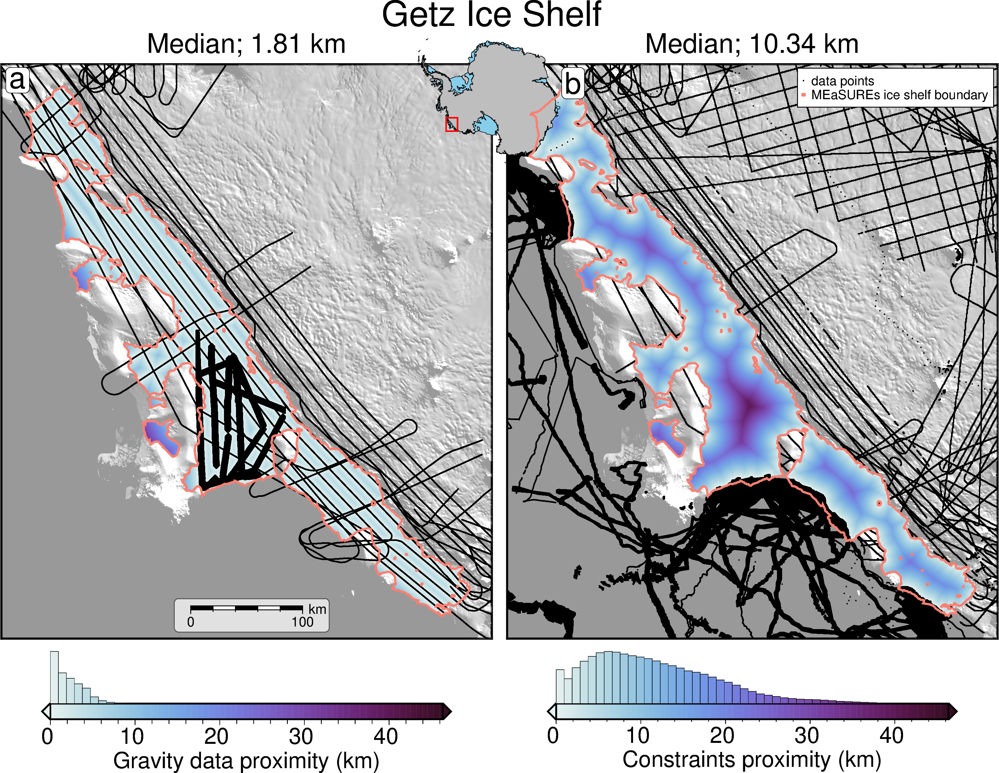

In [46]:
fig = maps.plot_grd(
    getz_grav_min_dist,
    region=region,
    cmap="dense",
    cpt_lims=cpt_lims,
    scalebar=True,
    scalebar_box="+gwhite@30+p0.5p,gray30,solid+r3p",
    modis_basemap=True,
    modis_version="125m",
    modis_transparency=60,
    hist=True,
    points=getz_grav_df,
    points_style="p1p",
    points_fill="black",
    cbar_label="Gravity data proximity (km)",
    cbar_font="20p,Helvetica",
)
fig.text(
    position="TC",
    justify="BC",
    text=f"Median; {round(np.nanmedian(getz_grav_min_dist),2)} km",
    offset=f"0c/.3c",
    font="20p,Helvetica",
    no_clip=True,
)
# plot constraints
fig.plot(
    getz_grav_df[["easting", "northing"]].iloc[0],
    style="p1p",
    fill="black",
)
# plot outline of ice shelf
fig.plot(
    getz_shp,
    pen="1.5p,salmon",
)

fig.text(
    position="TL",
    text="a",
    fill="white",
    pen=True,
    font="22p,Helvetica,black",
    offset="j.2/.2",
    clearance="+tO",
    no_clip=True,
)
fig.text(
    position="TR",
    justify="BC",
    text="Getz Ice Shelf",
    offset=f"0c/1c",
    font="26p,Helvetica",
    no_clip=True,
)

fig = maps.plot_grd(
    getz_constraints_min_dist,
    fig=fig,
    origin_shift="x",
    region=region,
    cmap="dense",
    cpt_lims=cpt_lims,
    inset=True,
    inset_width=0.3,
    inset_position="jTL+jTC+o-0.5/-1",
    modis_basemap=True,
    modis_version="125m",
    modis_transparency=60,
    hist=True,
    points=constraints_df,
    points_style="p1p",
    points_fill="black",
    cbar_label="Constraints proximity (km)",
    cbar_font="20p,Helvetica",
)
fig.text(
    position="TC",
    justify="BC",
    text=f"Median; {round(np.nanmedian(getz_constraints_min_dist),2)} km",
    offset=f"0c/.3c",
    font="20p,Helvetica",
    no_clip=True,
)
# plot constraints
fig.plot(
    constraints_df[["easting", "northing"]].iloc[0],
    style="p1p",
    fill="black",
    label="data points"
)
# plot outline of ice shelf
fig.plot(
    getz_shp,
    pen="1.5p,salmon",
    label="MEaSUREs ice shelf boundary"
)
fig.text(
    position="TL",
    text="b",
    fill="white",
    pen=True,
    font="22p,Helvetica,black",
    offset="j1.5/.2",
    clearance="+tO",
    no_clip=True,
)
fig.legend(
    position="JTR+jTR+o0.1c",
    box="+gwhite+p0.5p",
)
fig.show()